# WGAN With Gradient Clipping

In [1]:
import torch
from torch import nn
import matplotlib.pyplot as plt
from torchvision import transforms
from torchvision.datasets import FashionMNIST
from torch.utils.data import DataLoader
from torchvision.utils import save_image
import torchvision
import os

In [2]:
class Generator(nn.Module):
    def __init__(self, z_dim = 10, img_channels = 1, hidden_dim = 64):
        super(Generator, self).__init__()
        self.gen = nn.Sequential(
            self.gen_block(z_dim, hidden_dim * 16, 4, 1, 0),
            self.gen_block(hidden_dim*16, hidden_dim*8, 4, 2, 1),
            self.gen_block(hidden_dim*8, hidden_dim*4, 4, 2, 1),
            self.gen_block(hidden_dim*4, hidden_dim*2, 4, 2, 1),
            nn.ConvTranspose2d(hidden_dim*2, 1, kernel_size =4, stride = 2, padding = 1),
            nn.Tanh()
        )
        
    def gen_block(self, input_channels, output_channels, kernel_size, stride, padding):
        return nn.Sequential(
            nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride, padding, bias = False),
            nn.BatchNorm2d(output_channels),
            nn.ReLU()
        )
    
    def forward(self, noise):
        return self.gen(noise)

In [3]:
def get_noise(n_samples, z_dim):
    return torch.randn(n_samples, z_dim, 1, 1).to('cuda')

In [4]:
class Critic(nn.Module):
    def __init__(self, img_channels, hidden_dim = 64):
        super(Critic, self).__init__()
        self.critic = nn.Sequential(
            nn.Conv2d(img_channels, hidden_dim, kernel_size = 4, stride = 2, padding = 1),
            nn.LeakyReLU(0.2),
            self._block(hidden_dim, hidden_dim*2, 4, 2, 1),
            self._block(hidden_dim*2, hidden_dim*4, 4, 2, 1),
            self._block(hidden_dim*4, hidden_dim*8, 4, 2, 1),
            nn.Conv2d(hidden_dim*8, 1, kernel_size = 4, stride = 2, padding = 0), # 1x1 output
        )
        
    def _block(self, input_channels, output_channels, kernel_size, stride, padding):
        return nn.Sequential(
            nn.Conv2d(input_channels, output_channels, kernel_size, stride, padding, bias = False),
            nn.BatchNorm2d(output_channels),
            nn.LeakyReLU(0.2),
            )
        
    def forward(self, img):
        return self.critic(img)

In [5]:
def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(n.weight, 0.0, 0.02),
        torch.nn.init.normal_(m.bias, 0)
        

In [6]:
n_epochs = 100
steps = 100
z_dim = 100
batch_size = 64
beta_1 = 0.5
beta_2 = 0.999
lr = 0.00005
c_lambda = 10
critic_steps = 5
device = 'cuda'
image_size = 64

transform = transforms.Compose([
    transforms.Resize(image_size),
    transforms.ToTensor(),
    transforms.Normalize((0.5), (0.5))
])

dataloader = DataLoader(
    FashionMNIST(".", download = False, transform = transform),
    batch_size = batch_size,
    shuffle = True
)

In [7]:
gen = Generator(z_dim, 1, 64).to(device)
weights_init(gen)
gen_opt = torch.optim.RMSprop(gen.parameters(), lr = lr)

critic = Critic(1, 64).to(device)
weights_init(critic)
critic_opt = torch.optim.RMSprop(critic.parameters(), lr = lr)

In [8]:
import numpy as np

def matplotlib_imshow(img, one_channel=False):
    if one_channel:
        img = img.mean(dim=0)
    img = img / 2 + 0.5     # unnormalize
    img = img.detach().cpu()
    npimg = img.numpy()
    if one_channel:
        plt.imshow(npimg, cmap="Greys")
    else:
        plt.imshow(np.transpose(npimg, (1, 2, 0)))
    plt.show()

Epochs :  0  Step :  100  Generator Loss :  0.3627197818830609  Critic Loss :  -0.6384158208519218


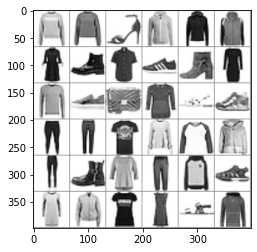

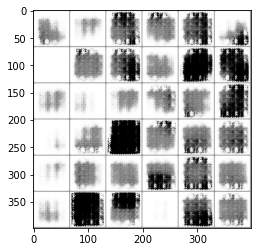

Epochs :  0  Step :  200  Generator Loss :  0.490897541064769  Critic Loss :  -0.9071489048078657


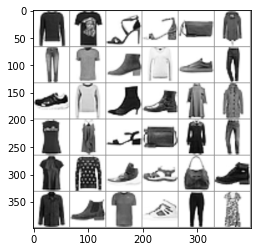

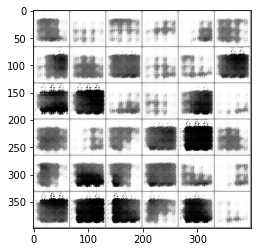

Epochs :  0  Step :  300  Generator Loss :  0.5124133064349492  Critic Loss :  -0.9459821648448709


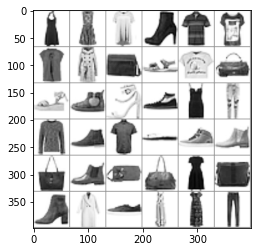

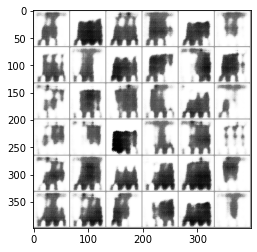

Epochs :  0  Step :  400  Generator Loss :  0.5443206963688135  Critic Loss :  -1.0186490279771387


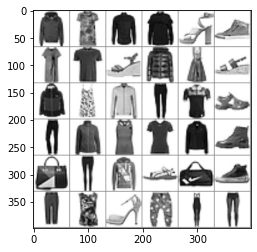

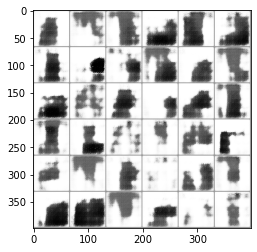

Epochs :  0  Step :  500  Generator Loss :  0.5766571069657802  Critic Loss :  -1.0972247529536483


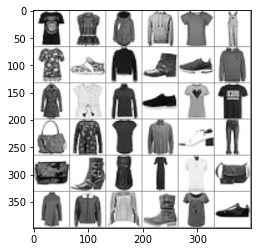

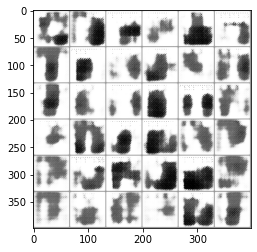

Epochs :  0  Step :  600  Generator Loss :  0.6014431825031837  Critic Loss :  -1.1536723886355758


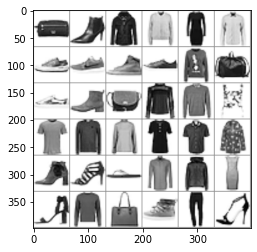

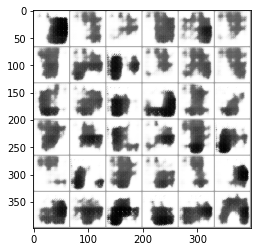

Epochs :  0  Step :  700  Generator Loss :  0.6195941875874996  Critic Loss :  -1.198618830751095


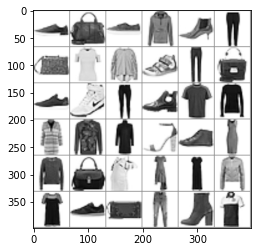

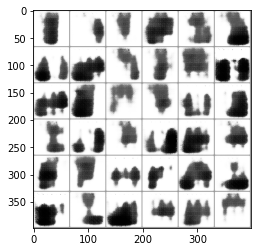

Epochs :  0  Step :  800  Generator Loss :  0.6333895388059319  Critic Loss :  -1.2310749080125243


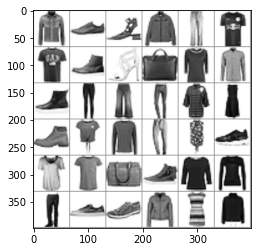

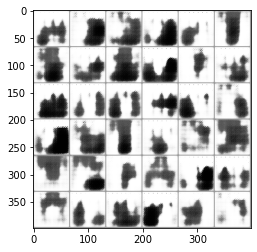

Epochs :  0  Step :  900  Generator Loss :  0.6434526051912043  Critic Loss :  -1.2522881177945275


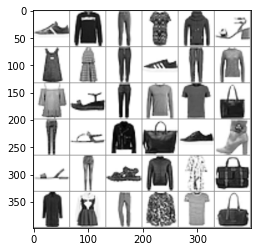

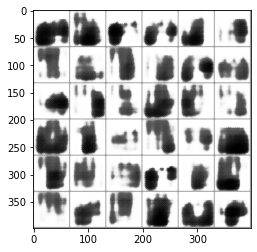

Epochs :  1  Step :  1000  Generator Loss :  0.6534507423192263  Critic Loss :  -1.2776135023370394


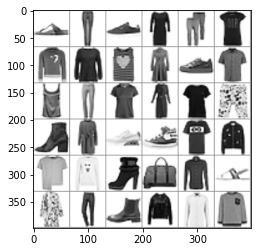

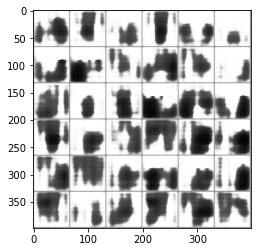

Epochs :  1  Step :  1100  Generator Loss :  0.6612930621477691  Critic Loss :  -1.2957235794514417


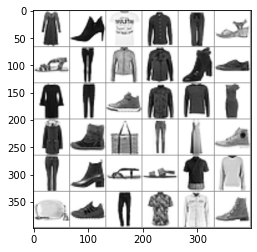

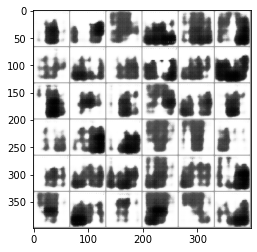

Epochs :  1  Step :  1200  Generator Loss :  0.6687454234187802  Critic Loss :  -1.3148130569222076


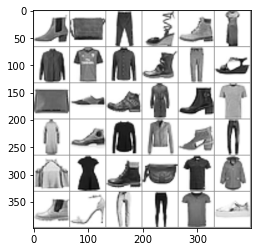

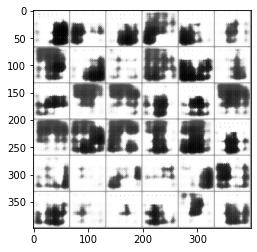

Epochs :  1  Step :  1300  Generator Loss :  0.6749483429124722  Critic Loss :  -1.3301158645210354


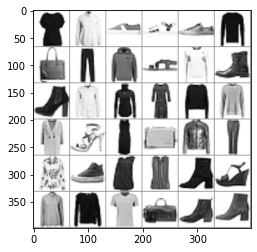

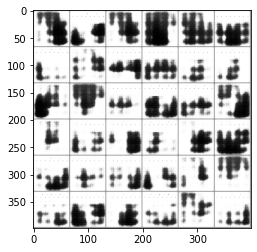

Epochs :  1  Step :  1400  Generator Loss :  0.678927548751235  Critic Loss :  -1.3394502049354575


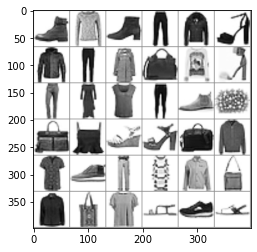

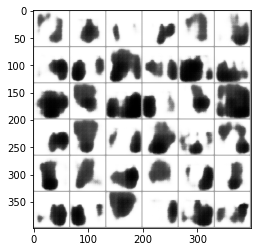

Epochs :  1  Step :  1500  Generator Loss :  0.6840130798121293  Critic Loss :  -1.352252077024183


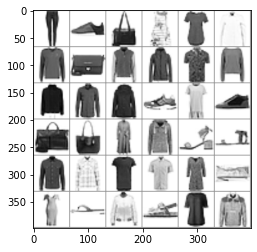

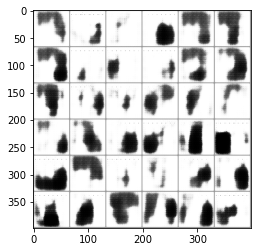

Epochs :  1  Step :  1600  Generator Loss :  0.6879642042238265  Critic Loss :  -1.3615630831690522


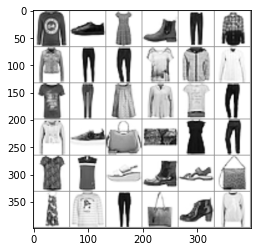

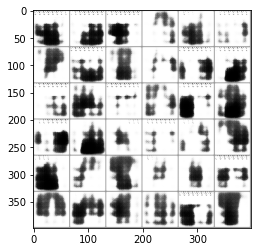

Epochs :  1  Step :  1700  Generator Loss :  0.6916448911235613  Critic Loss :  -1.3703519835025086


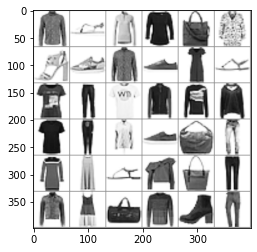

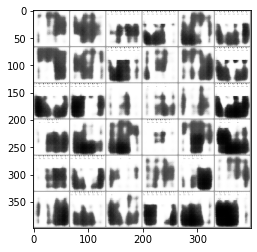

Epochs :  1  Step :  1800  Generator Loss :  0.694435626839598  Critic Loss :  -1.3763955796899072


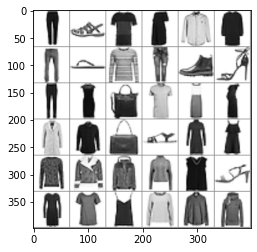

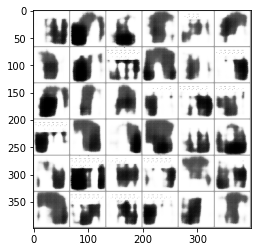

Epochs :  2  Step :  1900  Generator Loss :  0.696675676789723  Critic Loss :  -1.381026153016247


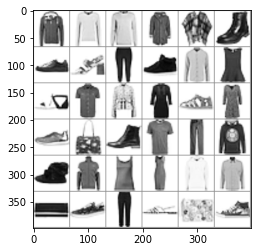

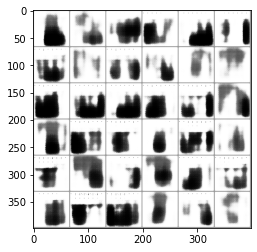

Epochs :  2  Step :  2000  Generator Loss :  0.6988295697234571  Critic Loss :  -1.387294372678548


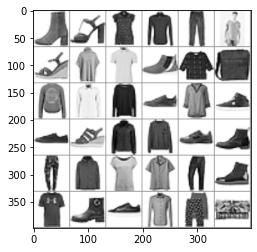

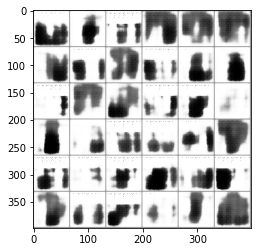

Epochs :  2  Step :  2100  Generator Loss :  0.7010088909062602  Critic Loss :  -1.392141952960974


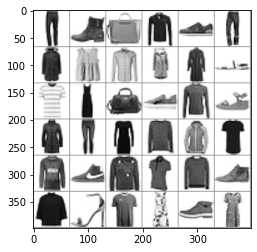

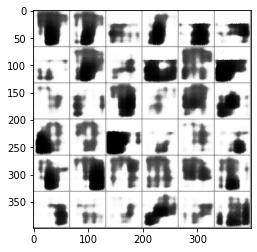

Epochs :  2  Step :  2200  Generator Loss :  0.7026191280206496  Critic Loss :  -1.396175184543161


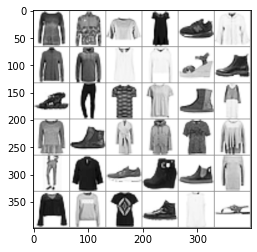

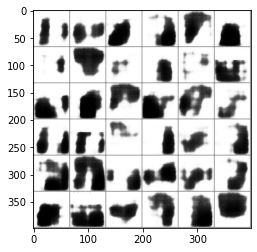

Epochs :  2  Step :  2300  Generator Loss :  0.7033359925092563  Critic Loss :  -1.3969245424588097


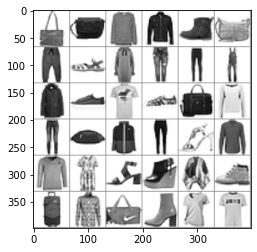

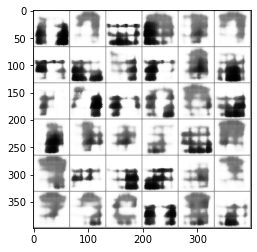

Epochs :  2  Step :  2400  Generator Loss :  0.7045274637794743  Critic Loss :  -1.3996145933450521


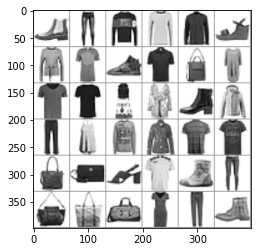

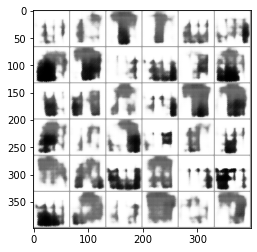

Epochs :  2  Step :  2500  Generator Loss :  0.7052461682230234  Critic Loss :  -1.400021269691588


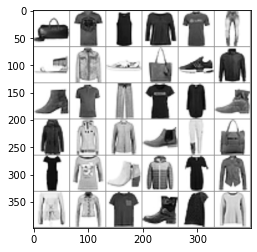

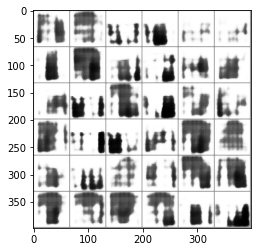

Epochs :  2  Step :  2600  Generator Loss :  0.7047310016160974  Critic Loss :  -1.396896779835799


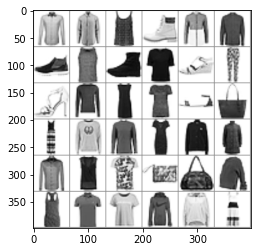

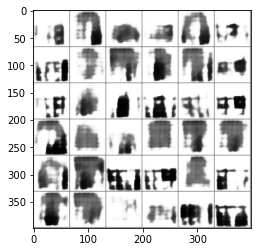

Epochs :  2  Step :  2700  Generator Loss :  0.7040591604538537  Critic Loss :  -1.3940584232150426


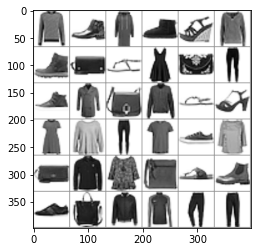

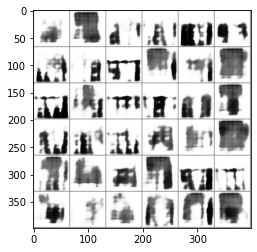

Epochs :  2  Step :  2800  Generator Loss :  0.7025657680710512  Critic Loss :  -1.3896254510352677


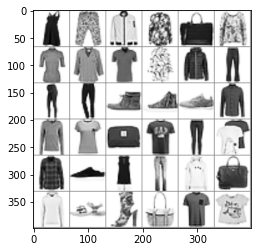

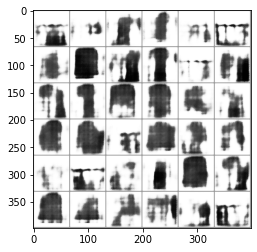

Epochs :  3  Step :  2900  Generator Loss :  0.701017635739569  Critic Loss :  -1.3848369918100818


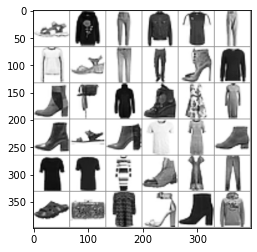

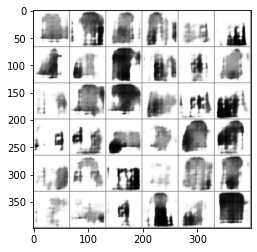

Epochs :  3  Step :  3000  Generator Loss :  0.7001133322889607  Critic Loss :  -1.3821761141007167


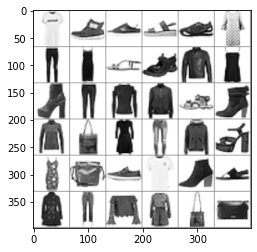

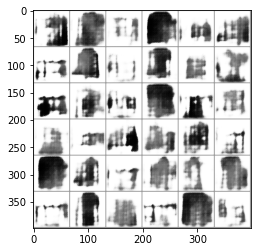

Epochs :  3  Step :  3100  Generator Loss :  0.6990380545021335  Critic Loss :  -1.3795656293500833


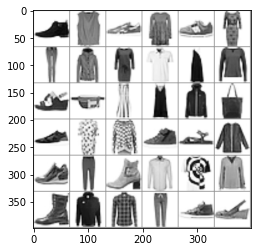

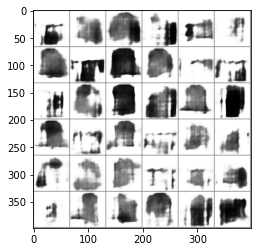

Epochs :  3  Step :  3200  Generator Loss :  0.699319901432682  Critic Loss :  -1.3808980234288617


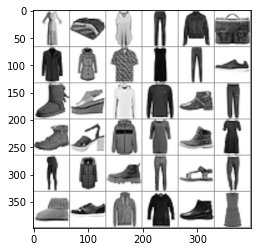

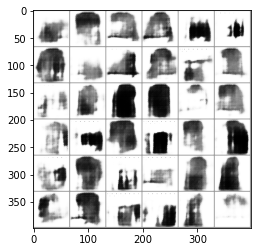

Epochs :  3  Step :  3300  Generator Loss :  0.6988517123461475  Critic Loss :  -1.3793563835119664


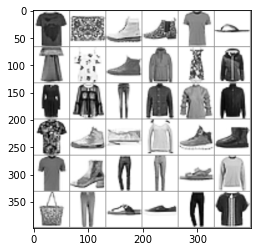

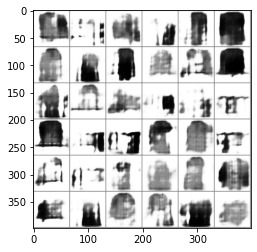

Epochs :  3  Step :  3400  Generator Loss :  0.6981715686619967  Critic Loss :  -1.3768810908886444


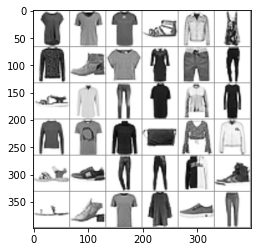

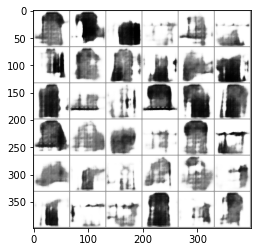

Epochs :  3  Step :  3500  Generator Loss :  0.697712016505921  Critic Loss :  -1.375911305026071


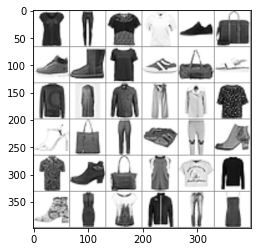

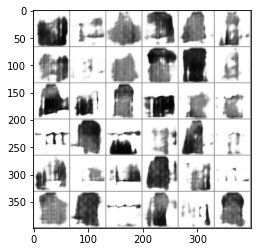

Epochs :  3  Step :  3600  Generator Loss :  0.6967846663131301  Critic Loss :  -1.3727339990987553


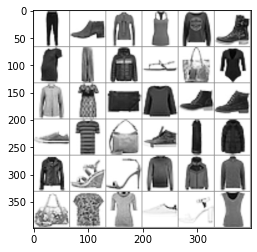

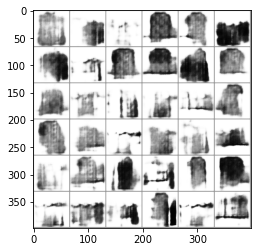

Epochs :  3  Step :  3700  Generator Loss :  0.695977449320521  Critic Loss :  -1.3707095384875672


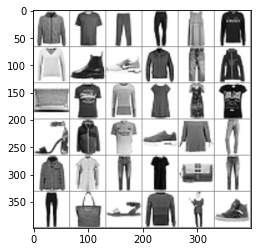

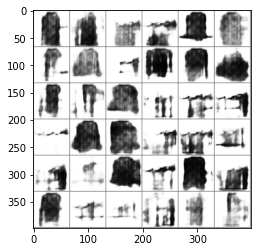

Epochs :  4  Step :  3800  Generator Loss :  0.6955046405134061  Critic Loss :  -1.3693982982749213


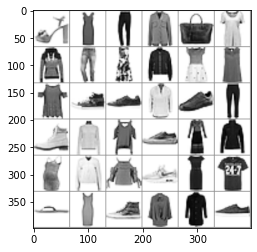

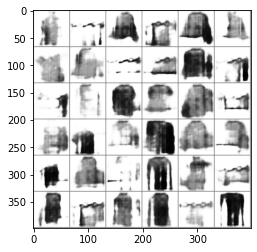

Epochs :  4  Step :  3900  Generator Loss :  0.6950919952779077  Critic Loss :  -1.3691824944496915


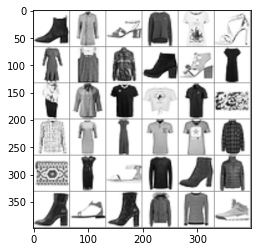

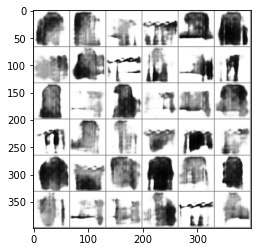

Epochs :  4  Step :  4000  Generator Loss :  0.6948754875455634  Critic Loss :  -1.36837122654058


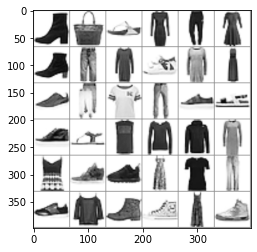

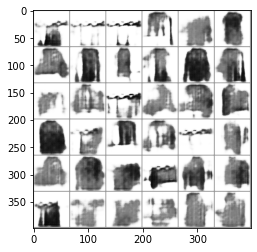

Epochs :  4  Step :  4100  Generator Loss :  0.6938718830176811  Critic Loss :  -1.3651546411169009


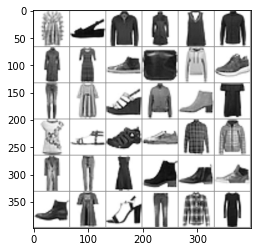

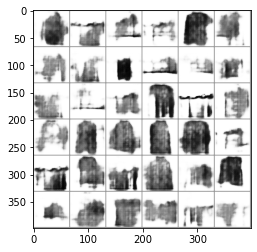

Epochs :  4  Step :  4200  Generator Loss :  0.693026936943033  Critic Loss :  -1.362570104122517


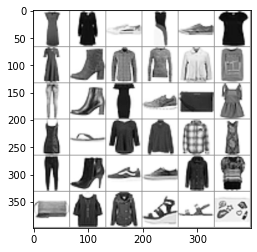

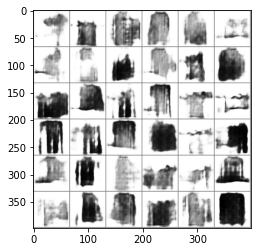

Epochs :  4  Step :  4300  Generator Loss :  0.6923162029389573  Critic Loss :  -1.3605538701141295


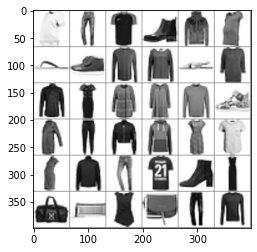

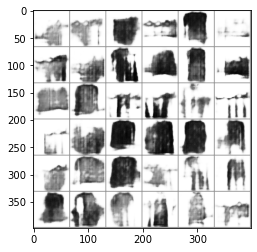

Epochs :  4  Step :  4400  Generator Loss :  0.691595203810509  Critic Loss :  -1.3583397739600724


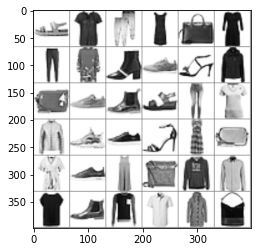

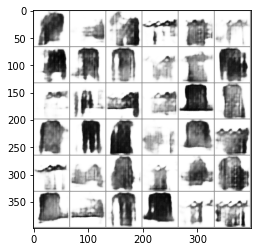

Epochs :  4  Step :  4500  Generator Loss :  0.6912796527296822  Critic Loss :  -1.3573854804532397


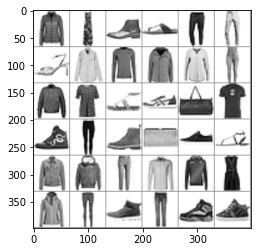

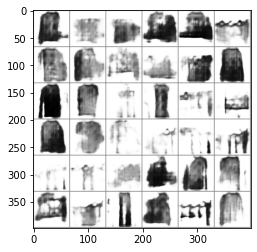

Epochs :  4  Step :  4600  Generator Loss :  0.6906103530218926  Critic Loss :  -1.3554422509323647


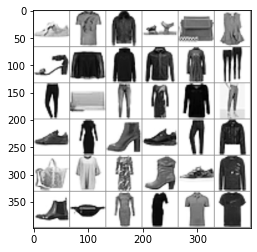

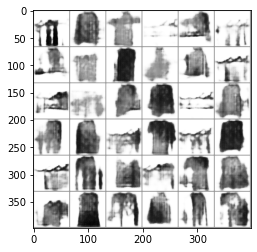

Epochs :  5  Step :  4700  Generator Loss :  0.6899988701448657  Critic Loss :  -1.3535631285477845


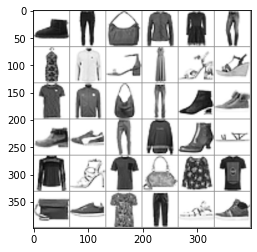

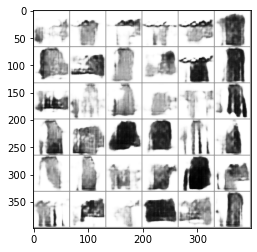

Epochs :  5  Step :  4800  Generator Loss :  0.6897382532014066  Critic Loss :  -1.3528702852642187


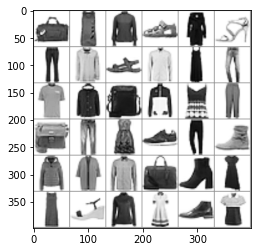

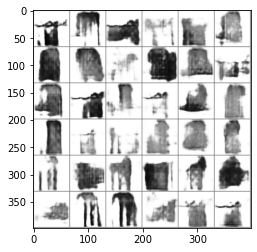

Epochs :  5  Step :  4900  Generator Loss :  0.6889827800238486  Critic Loss :  -1.3503508685343757


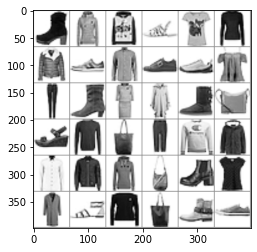

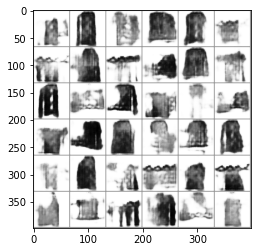

Epochs :  5  Step :  5000  Generator Loss :  0.688735385073768  Critic Loss :  -1.3500217588332326


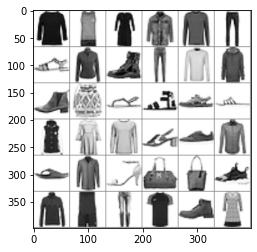

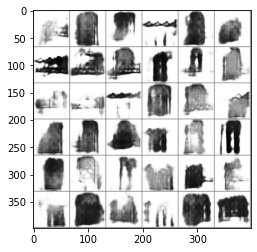

Epochs :  5  Step :  5100  Generator Loss :  0.6882845648846078  Critic Loss :  -1.3488101145873495


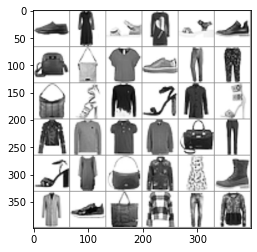

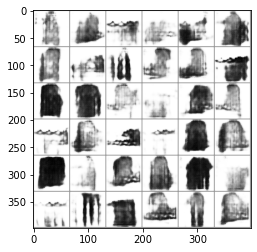

Epochs :  5  Step :  5200  Generator Loss :  0.687930590913031  Critic Loss :  -1.3478457794467444


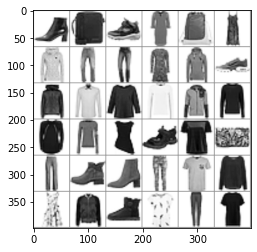

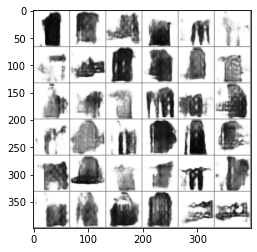

Epochs :  5  Step :  5300  Generator Loss :  0.6872229104517643  Critic Loss :  -1.3460387174658637


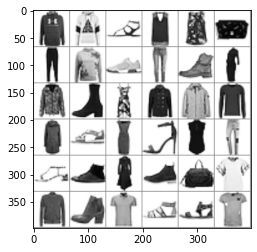

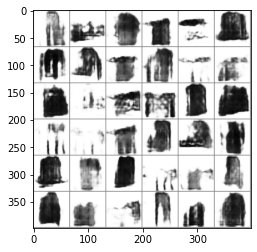

Epochs :  5  Step :  5400  Generator Loss :  0.6866840731442682  Critic Loss :  -1.3455044840797805


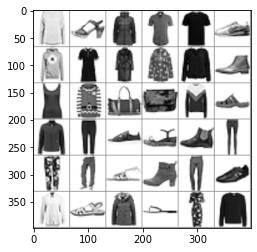

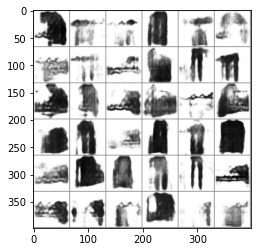

Epochs :  5  Step :  5500  Generator Loss :  0.6860364457497966  Critic Loss :  -1.34444151849774


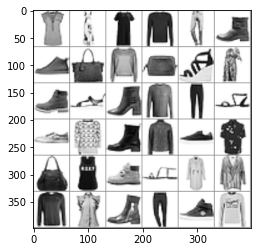

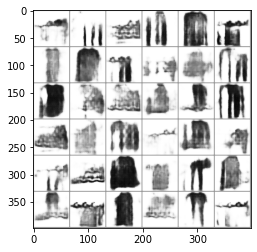

Epochs :  5  Step :  5600  Generator Loss :  0.6853039782301805  Critic Loss :  -1.3431516105439538


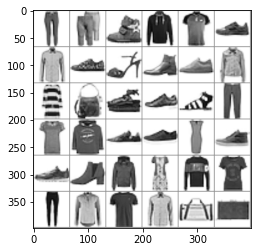

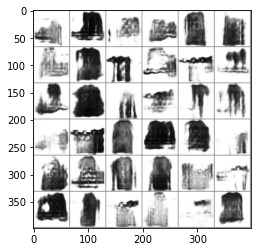

Epochs :  6  Step :  5700  Generator Loss :  0.6848149727095785  Critic Loss :  -1.3426780097539512


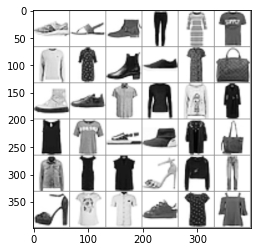

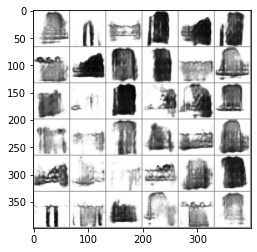

Epochs :  6  Step :  5800  Generator Loss :  0.6838258878196638  Critic Loss :  -1.3408855271681135


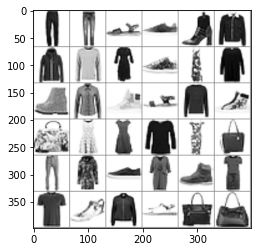

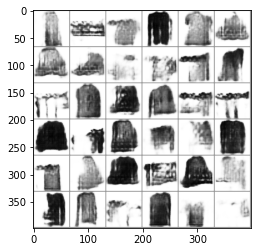

Epochs :  6  Step :  5900  Generator Loss :  0.6827100141905643  Critic Loss :  -1.3385901845271826


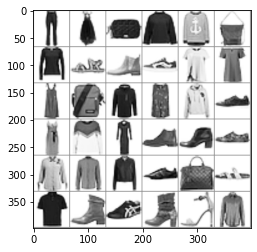

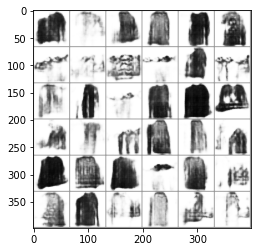

Epochs :  6  Step :  6000  Generator Loss :  0.6819162715794906  Critic Loss :  -1.3373754876943944


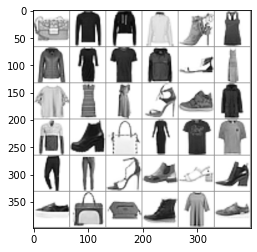

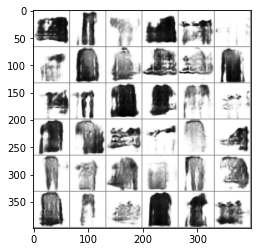

Epochs :  6  Step :  6100  Generator Loss :  0.6812098090250244  Critic Loss :  -1.3357653889384933


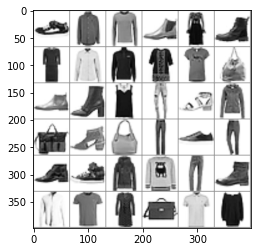

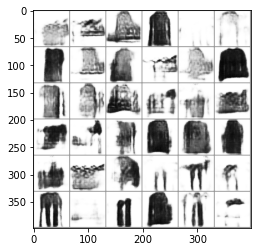

Epochs :  6  Step :  6200  Generator Loss :  0.680597853621866  Critic Loss :  -1.3342550910040758


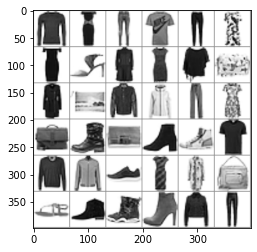

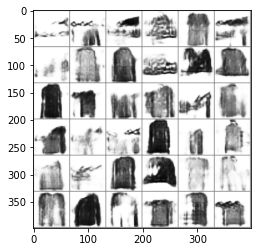

Epochs :  6  Step :  6300  Generator Loss :  0.679733579530462  Critic Loss :  -1.3326754105547625


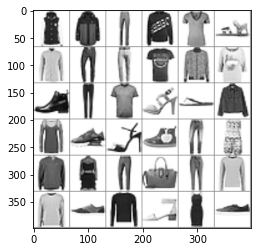

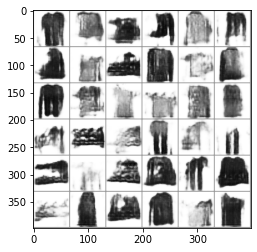

Epochs :  6  Step :  6400  Generator Loss :  0.6787665626909074  Critic Loss :  -1.3302901091717678


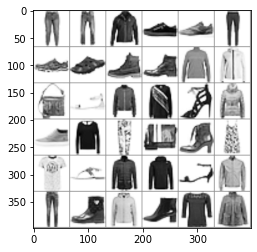

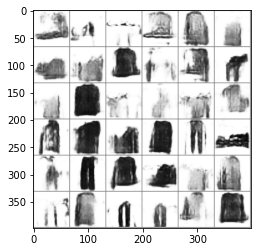

Epochs :  6  Step :  6500  Generator Loss :  0.6777327114227945  Critic Loss :  -1.328407640465639


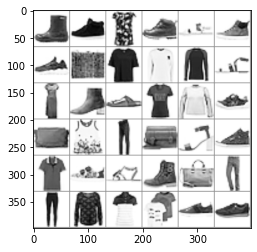

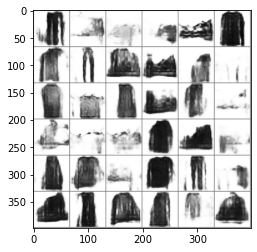

Epochs :  7  Step :  6600  Generator Loss :  0.676918216813532  Critic Loss :  -1.3267346703611116


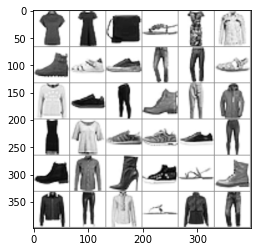

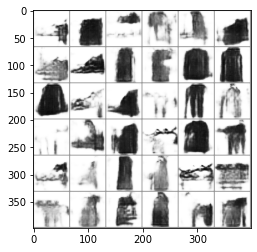

Epochs :  7  Step :  6700  Generator Loss :  0.6763773532041154  Critic Loss :  -1.3261806353928907


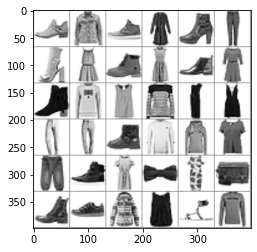

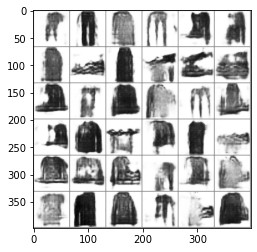

Epochs :  7  Step :  6800  Generator Loss :  0.6760936542903415  Critic Loss :  -1.325712313295508


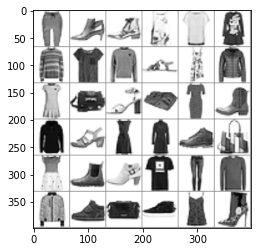

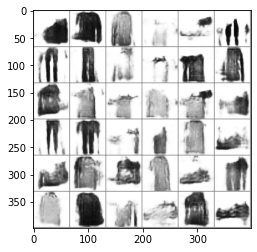

Epochs :  7  Step :  6900  Generator Loss :  0.6759177281579637  Critic Loss :  -1.3255766645205653


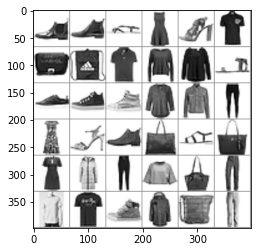

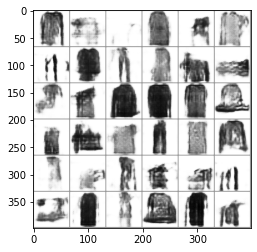

Epochs :  7  Step :  7000  Generator Loss :  0.6759615742922428  Critic Loss :  -1.326176340620223


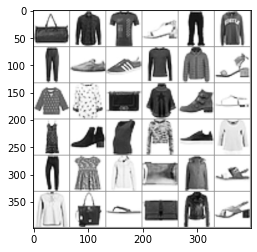

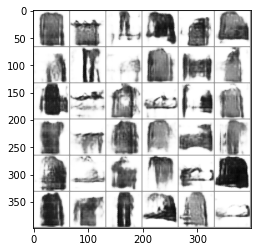

Epochs :  7  Step :  7100  Generator Loss :  0.6757372969385355  Critic Loss :  -1.3257595220462142


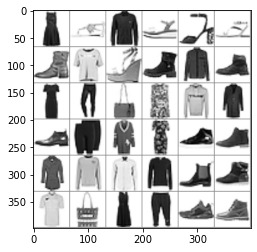

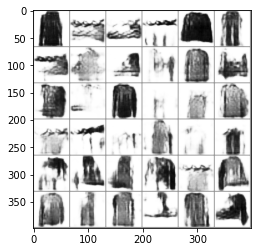

Epochs :  7  Step :  7200  Generator Loss :  0.6755729349450686  Critic Loss :  -1.3254137672866821


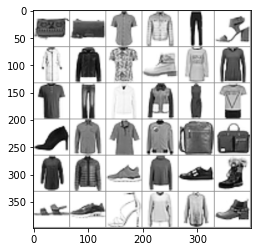

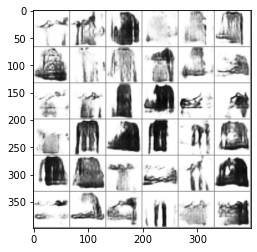

Epochs :  7  Step :  7300  Generator Loss :  0.6754625866405526  Critic Loss :  -1.325510316410499


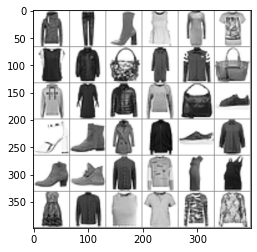

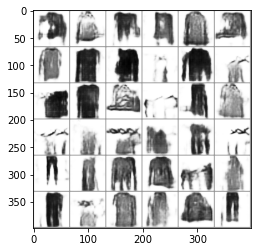

Epochs :  7  Step :  7400  Generator Loss :  0.6751756938483024  Critic Loss :  -1.3250838100372562


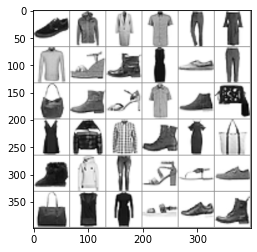

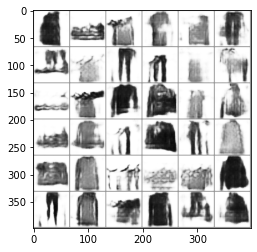

Epochs :  7  Step :  7500  Generator Loss :  0.674700217578467  Critic Loss :  -1.3243939115645504


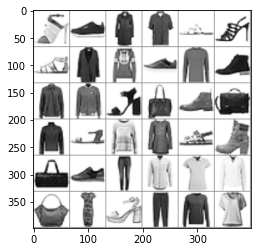

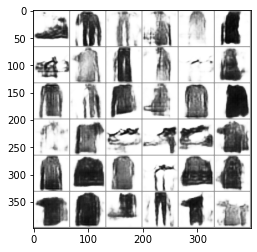

Epochs :  8  Step :  7600  Generator Loss :  0.6743401747678811  Critic Loss :  -1.3236154231235011


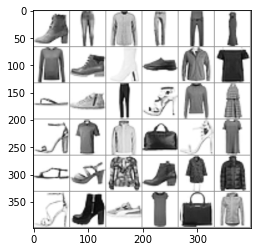

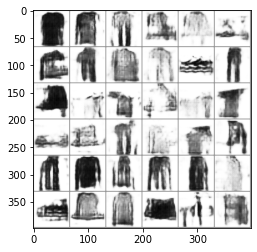

Epochs :  8  Step :  7700  Generator Loss :  0.6743294990654466  Critic Loss :  -1.3241358869193844


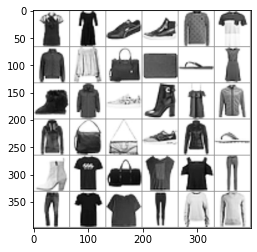

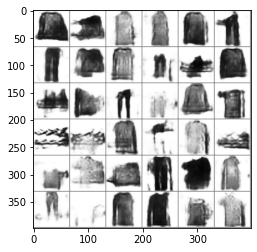

Epochs :  8  Step :  7800  Generator Loss :  0.6737897933393012  Critic Loss :  -1.323089520991807


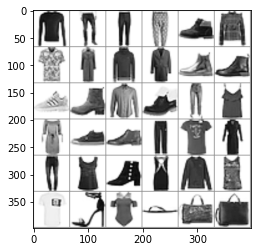

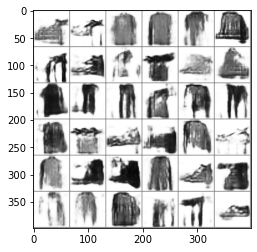

Epochs :  8  Step :  7900  Generator Loss :  0.6735044095598315  Critic Loss :  -1.3228701449038511


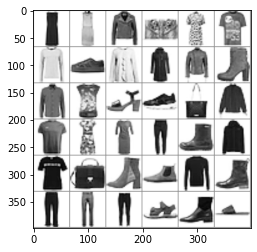

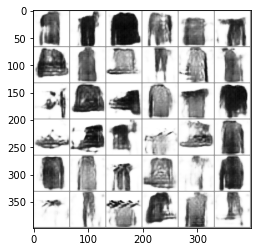

Epochs :  8  Step :  8000  Generator Loss :  0.6729979126769177  Critic Loss :  -1.3218267501184737


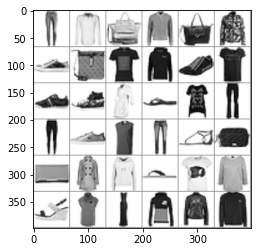

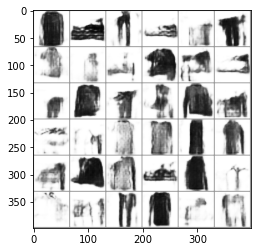

Epochs :  8  Step :  8100  Generator Loss :  0.6724531021837524  Critic Loss :  -1.3215194251730513


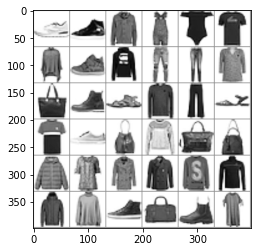

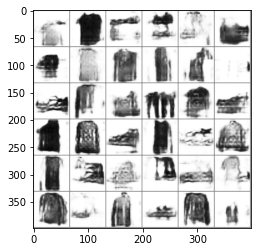

Epochs :  8  Step :  8200  Generator Loss :  0.6719976221137715  Critic Loss :  -1.320926948842663


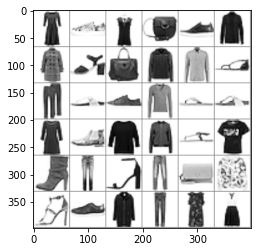

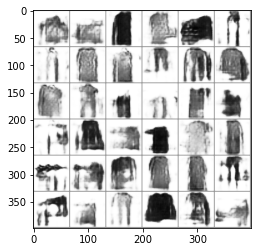

Epochs :  8  Step :  8300  Generator Loss :  0.6713582477556171  Critic Loss :  -1.319645468456381


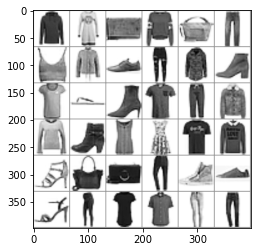

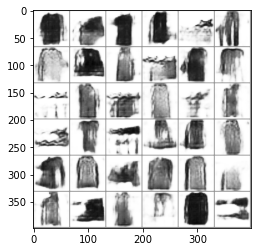

Epochs :  8  Step :  8400  Generator Loss :  0.6706842253125728  Critic Loss :  -1.3182930682168503


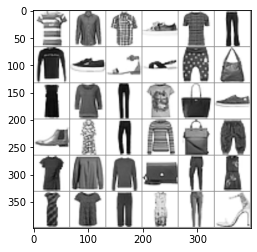

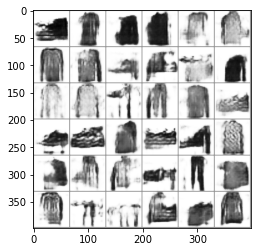

Epochs :  9  Step :  8500  Generator Loss :  0.6701164069174899  Critic Loss :  -1.316901220788853


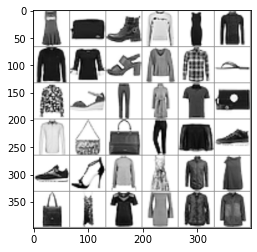

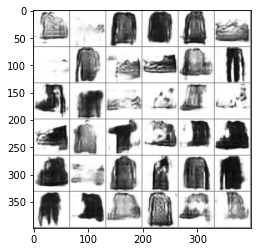

Epochs :  9  Step :  8600  Generator Loss :  0.6699628325845494  Critic Loss :  -1.316815625793195


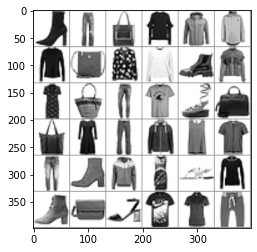

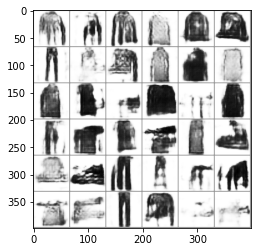

Epochs :  9  Step :  8700  Generator Loss :  0.669223140293074  Critic Loss :  -1.315512240379195


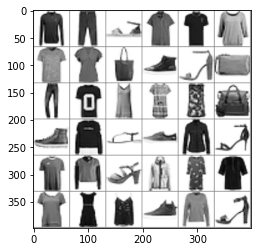

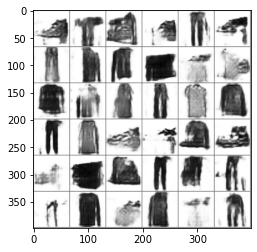

Epochs :  9  Step :  8800  Generator Loss :  0.6682812187417717  Critic Loss :  -1.3137513051806886


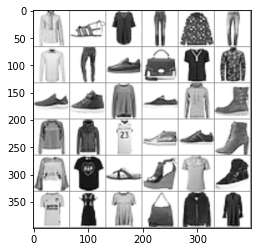

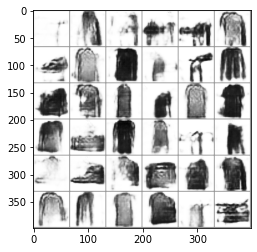

Epochs :  9  Step :  8900  Generator Loss :  0.6674549181192454  Critic Loss :  -1.312015738956214


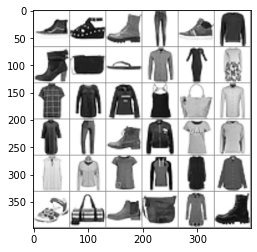

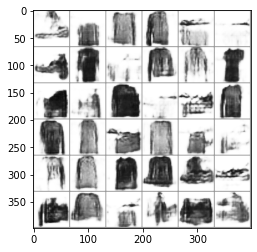

Epochs :  9  Step :  9000  Generator Loss :  0.6667477069915427  Critic Loss :  -1.310928274411132


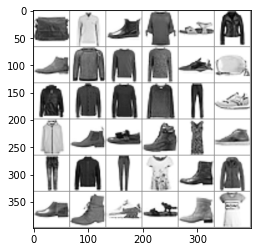

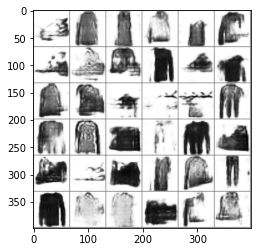

Epochs :  9  Step :  9100  Generator Loss :  0.6661473185327774  Critic Loss :  -1.3096645649791117


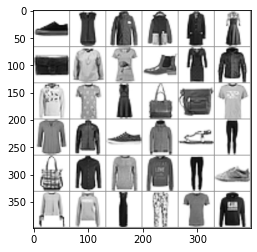

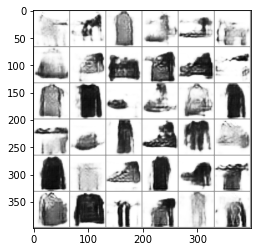

Epochs :  9  Step :  9200  Generator Loss :  0.6652835731779518  Critic Loss :  -1.3082781324874146


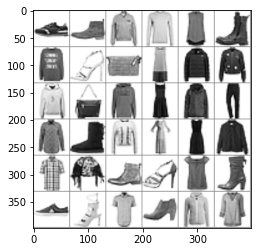

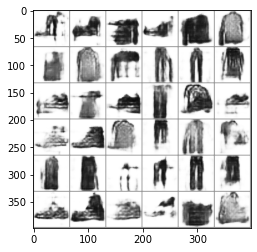

Epochs :  9  Step :  9300  Generator Loss :  0.6646421372430069  Critic Loss :  -1.3070934807230412


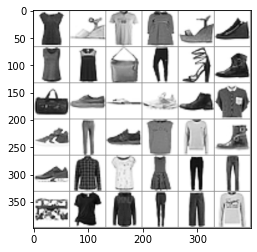

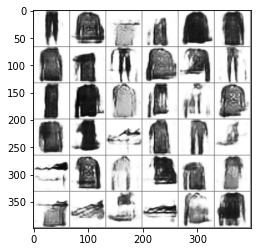

Epochs :  10  Step :  9400  Generator Loss :  0.6639144295709891  Critic Loss :  -1.3057344647837792


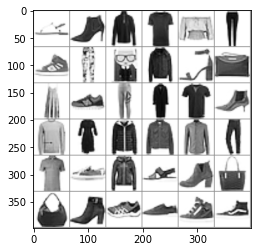

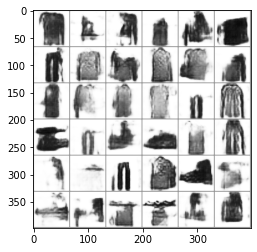

Epochs :  10  Step :  9500  Generator Loss :  0.6632009455512866  Critic Loss :  -1.304489271709953


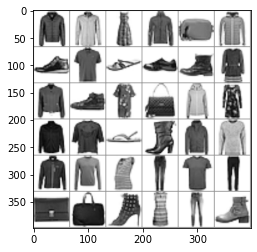

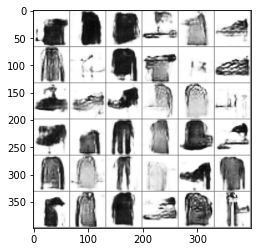

Epochs :  10  Step :  9600  Generator Loss :  0.6624664561237296  Critic Loss :  -1.303007835567776


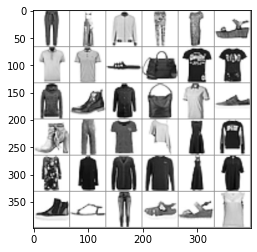

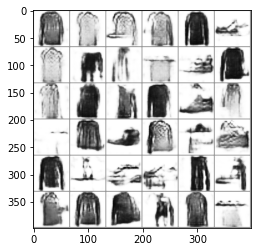

Epochs :  10  Step :  9700  Generator Loss :  0.6615573726106944  Critic Loss :  -1.3011709801980231


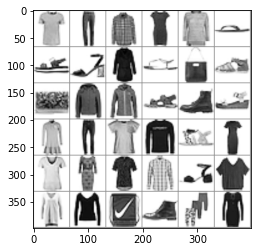

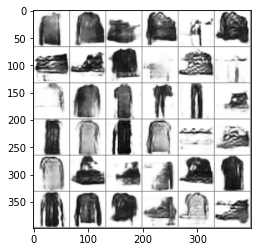

Epochs :  10  Step :  9800  Generator Loss :  0.6605553562796855  Critic Loss :  -1.2995571265441148


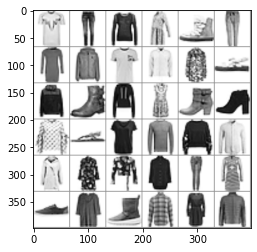

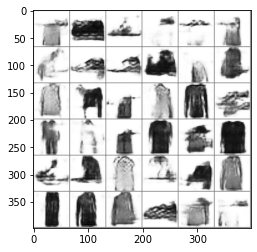

Epochs :  10  Step :  9900  Generator Loss :  0.6599732516741033  Critic Loss :  -1.298431954057683


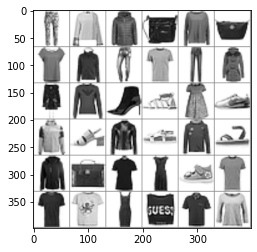

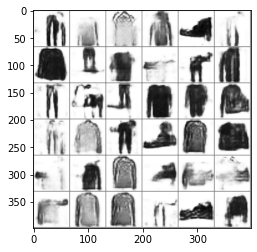

Epochs :  10  Step :  10000  Generator Loss :  0.6596055919871898  Critic Loss :  -1.297977270586642


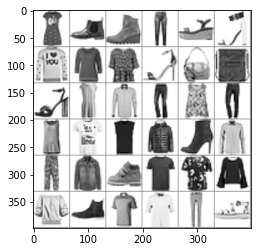

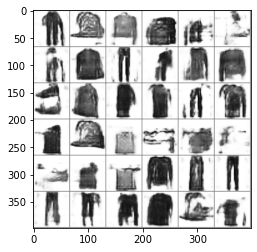

Epochs :  10  Step :  10100  Generator Loss :  0.6595546884865426  Critic Loss :  -1.297803705007872


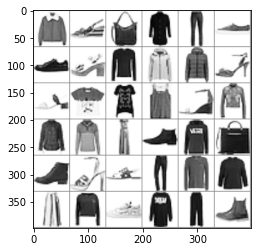

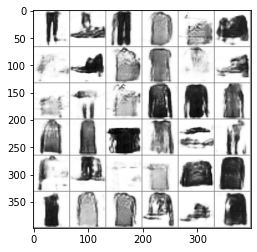

Epochs :  10  Step :  10200  Generator Loss :  0.6590394190873029  Critic Loss :  -1.2972175615974793


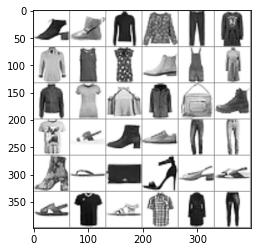

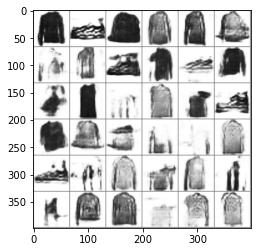

Epochs :  10  Step :  10300  Generator Loss :  0.6586704118382322  Critic Loss :  -1.2965167165041251


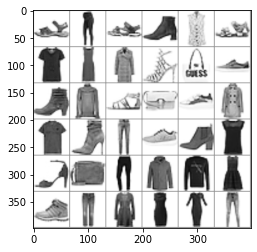

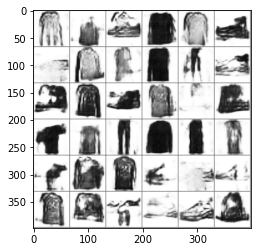

Epochs :  11  Step :  10400  Generator Loss :  0.658458723290801  Critic Loss :  -1.2961537409466675


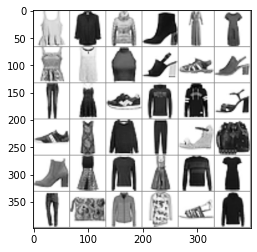

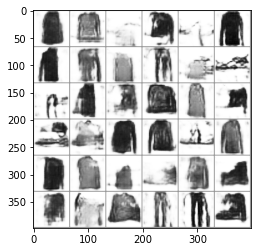

Epochs :  11  Step :  10500  Generator Loss :  0.6582458666034176  Critic Loss :  -1.2956373212946657


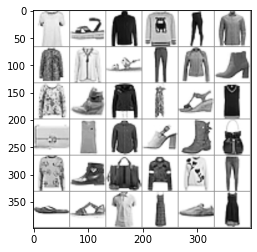

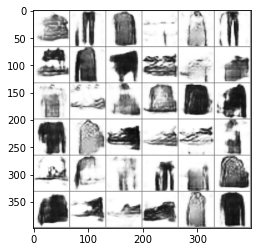

Epochs :  11  Step :  10600  Generator Loss :  0.6580053401393772  Critic Loss :  -1.2951963335238035


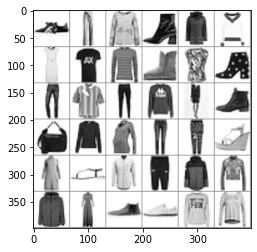

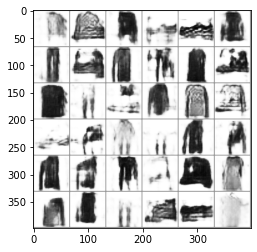

Epochs :  11  Step :  10700  Generator Loss :  0.6578816460184187  Critic Loss :  -1.2953548299387851


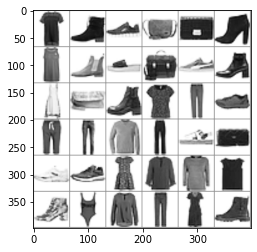

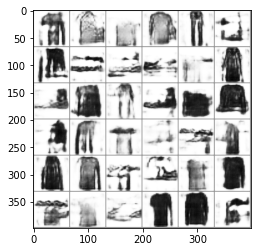

Epochs :  11  Step :  10800  Generator Loss :  0.6573934027790393  Critic Loss :  -1.2937897717248015


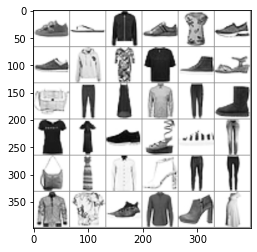

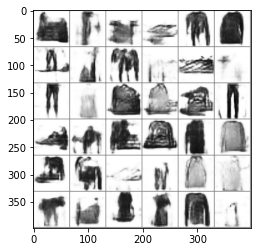

Epochs :  11  Step :  10900  Generator Loss :  0.6574048164606291  Critic Loss :  -1.2939393013225295


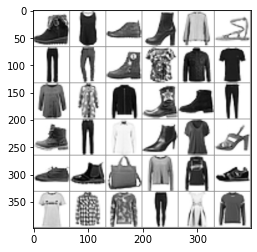

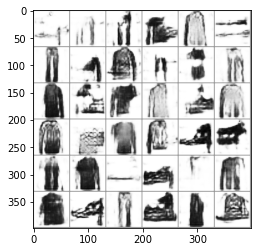

Epochs :  11  Step :  11000  Generator Loss :  0.6573614521226211  Critic Loss :  -1.2942469529828218


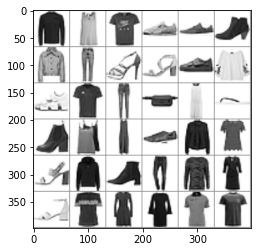

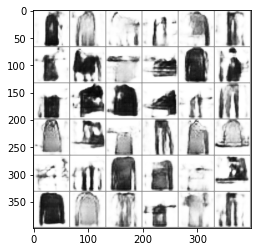

Epochs :  11  Step :  11100  Generator Loss :  0.6572085791676692  Critic Loss :  -1.2941538464060829


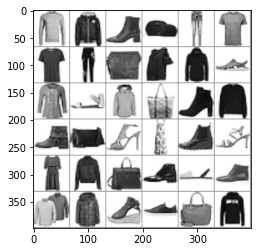

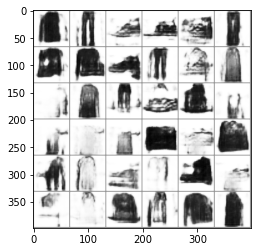

Epochs :  11  Step :  11200  Generator Loss :  0.6566840870214219  Critic Loss :  -1.2932226572802075


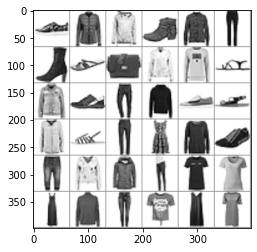

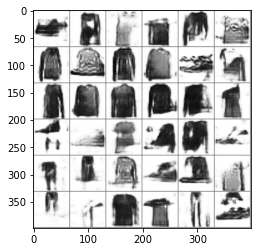

Epochs :  12  Step :  11300  Generator Loss :  0.6565934044460403  Critic Loss :  -1.2930344373440374


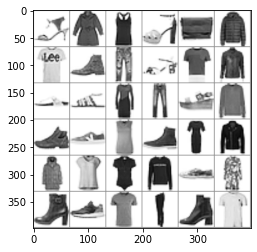

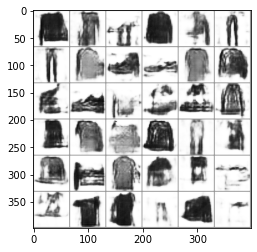

Epochs :  12  Step :  11400  Generator Loss :  0.6561588341422305  Critic Loss :  -1.2921904249619023


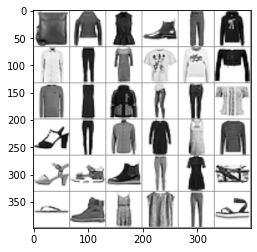

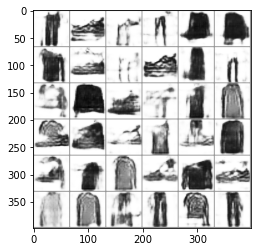

Epochs :  12  Step :  11500  Generator Loss :  0.6555082756633789  Critic Loss :  -1.2909501342627325


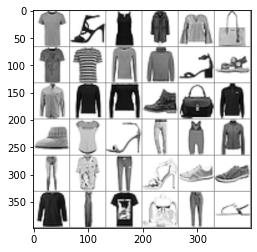

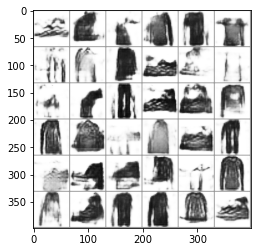

Epochs :  12  Step :  11600  Generator Loss :  0.655377075766988  Critic Loss :  -1.2904847702496056


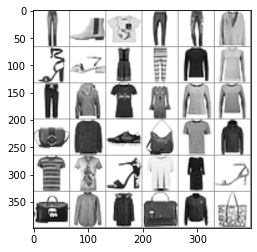

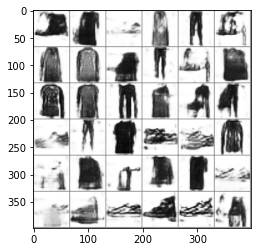

Epochs :  12  Step :  11700  Generator Loss :  0.6553176291322964  Critic Loss :  -1.290075047389467


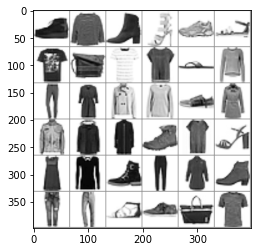

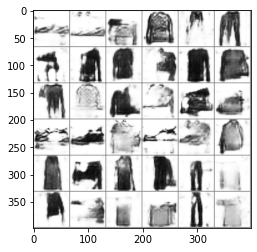

Epochs :  12  Step :  11800  Generator Loss :  0.6549800275383967  Critic Loss :  -1.2893489612350062


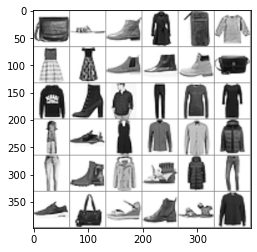

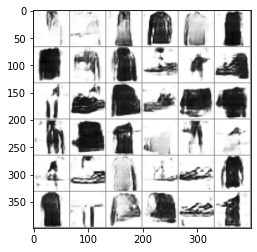

Epochs :  12  Step :  11900  Generator Loss :  0.6544490814211528  Critic Loss :  -1.288046792903772


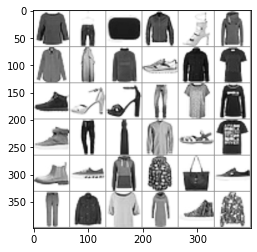

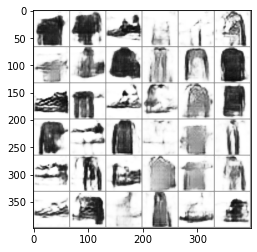

Epochs :  12  Step :  12000  Generator Loss :  0.6541706529479513  Critic Loss :  -1.2878501377611409


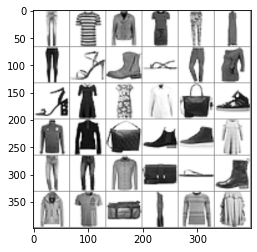

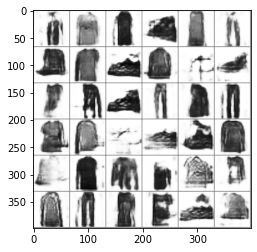

Epochs :  12  Step :  12100  Generator Loss :  0.6527403466646129  Critic Loss :  -1.284436149177502


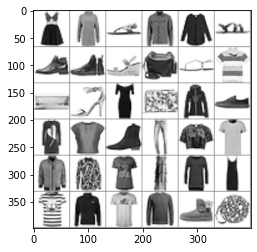

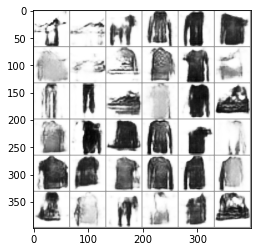

Epochs :  13  Step :  12200  Generator Loss :  0.6525338016556705  Critic Loss :  -1.2840425138410287


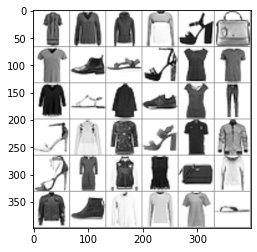

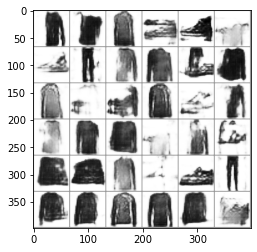

Epochs :  13  Step :  12300  Generator Loss :  0.6520120534771198  Critic Loss :  -1.283405364088925


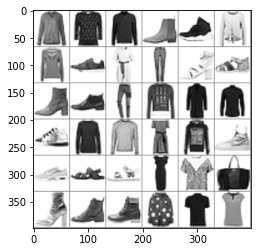

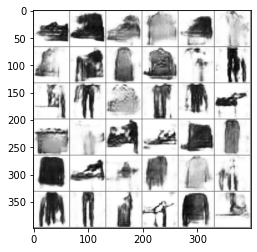

Epochs :  13  Step :  12400  Generator Loss :  0.6502779499066791  Critic Loss :  -1.279297929868851


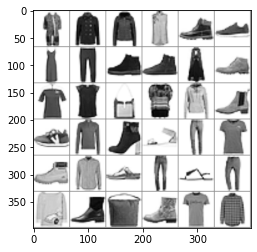

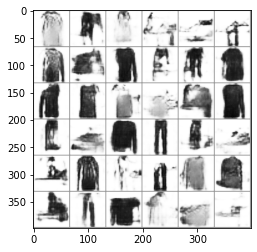

Epochs :  13  Step :  12500  Generator Loss :  0.6496764237331786  Critic Loss :  -1.2783524577081482


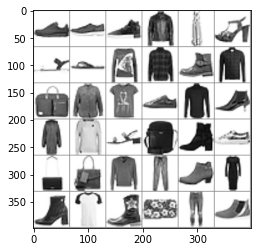

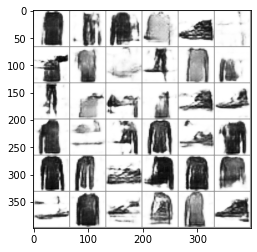

Epochs :  13  Step :  12600  Generator Loss :  0.6491514143359751  Critic Loss :  -1.277140328901892


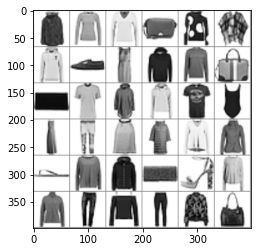

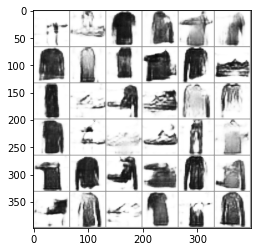

Epochs :  13  Step :  12700  Generator Loss :  0.6486677798558591  Critic Loss :  -1.2763607101841978


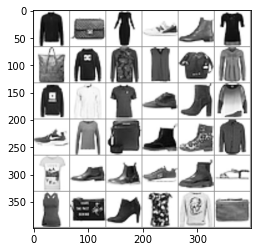

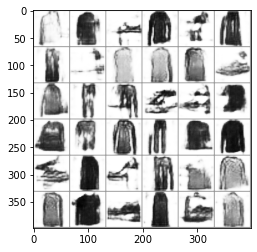

Epochs :  13  Step :  12800  Generator Loss :  0.6482443803634851  Critic Loss :  -1.2754526711658383


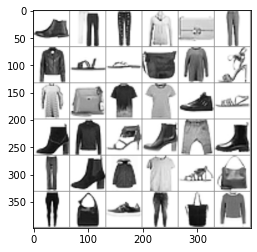

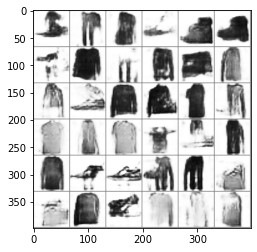

Epochs :  13  Step :  12900  Generator Loss :  0.6480487708321614  Critic Loss :  -1.2751150133709384


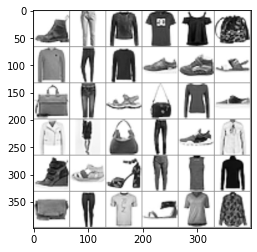

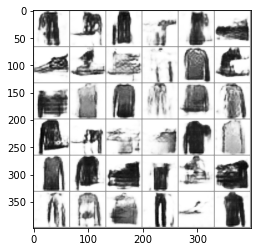

Epochs :  13  Step :  13000  Generator Loss :  0.6476980565121003  Critic Loss :  -1.2742516973410938


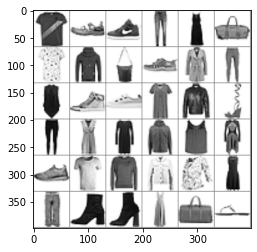

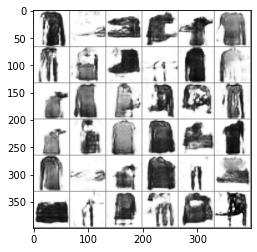

Epochs :  13  Step :  13100  Generator Loss :  0.6471798549761875  Critic Loss :  -1.2735751802632629


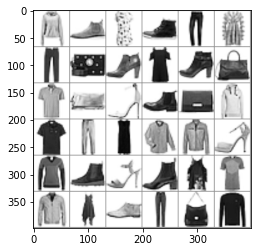

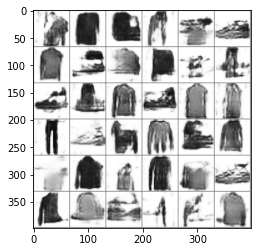

Epochs :  14  Step :  13200  Generator Loss :  0.6467767090490264  Critic Loss :  -1.2726113766036946


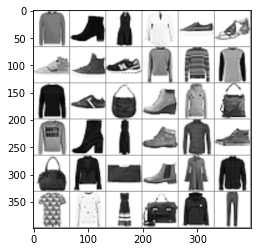

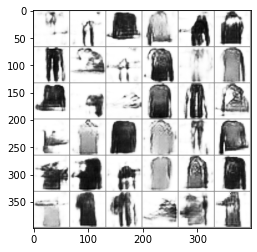

Epochs :  14  Step :  13300  Generator Loss :  0.6463751525428545  Critic Loss :  -1.2719764454295543


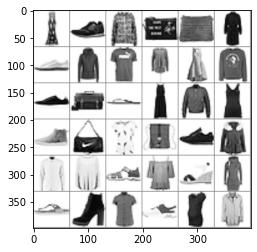

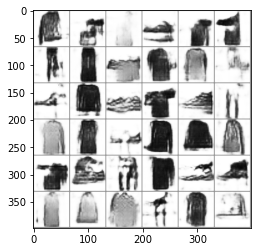

Epochs :  14  Step :  13400  Generator Loss :  0.6459509258629205  Critic Loss :  -1.2710047184782922


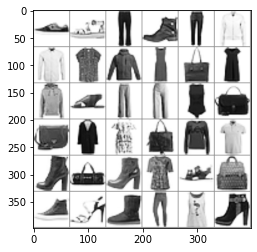

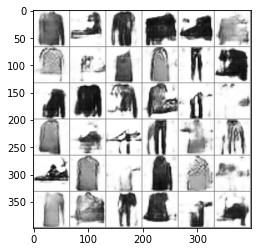

Epochs :  14  Step :  13500  Generator Loss :  0.6443977065766058  Critic Loss :  -1.2676571023522931


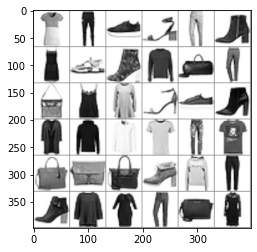

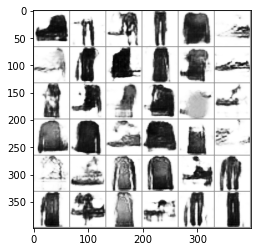

Epochs :  14  Step :  13600  Generator Loss :  0.6430981746215463  Critic Loss :  -1.2650942573816035


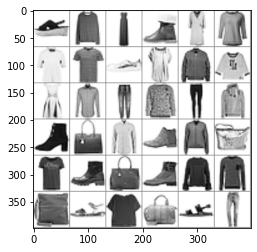

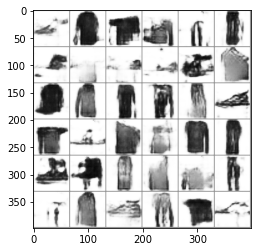

Epochs :  14  Step :  13700  Generator Loss :  0.6426443869466417  Critic Loss :  -1.263977664586098


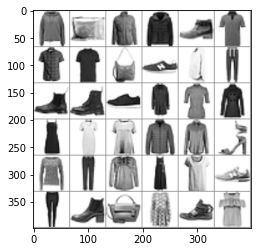

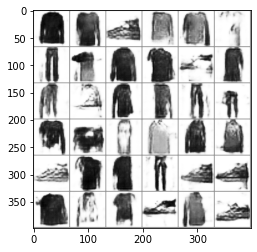

Epochs :  14  Step :  13800  Generator Loss :  0.6418260505846263  Critic Loss :  -1.2626182713207563


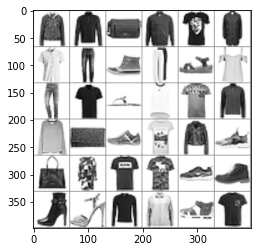

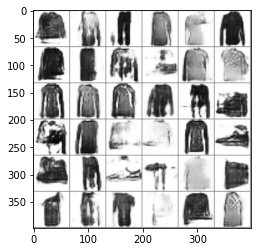

Epochs :  14  Step :  13900  Generator Loss :  0.6415157180626394  Critic Loss :  -1.2617605350331864


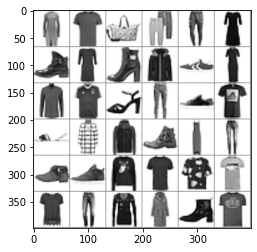

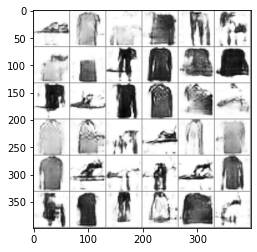

Epochs :  14  Step :  14000  Generator Loss :  0.6409966154160877  Critic Loss :  -1.260696917507925


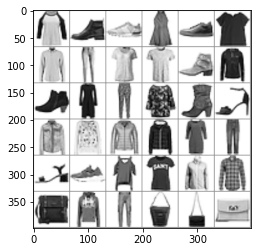

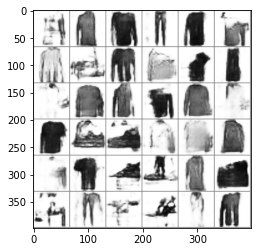

Epochs :  15  Step :  14100  Generator Loss :  0.6403622091710667  Critic Loss :  -1.2591470281154338


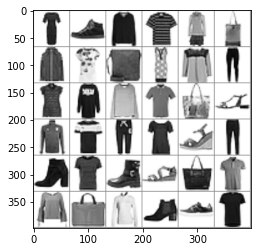

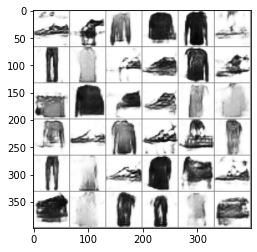

Epochs :  15  Step :  14200  Generator Loss :  0.6396943868932635  Critic Loss :  -1.2577398407849842


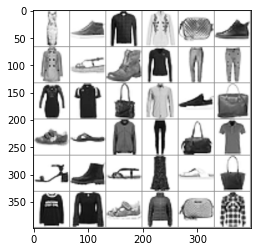

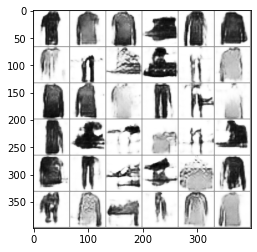

Epochs :  15  Step :  14300  Generator Loss :  0.6390988502343888  Critic Loss :  -1.2563003491312483


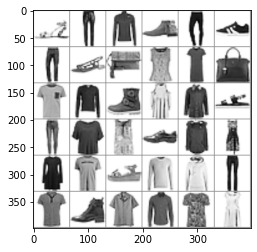

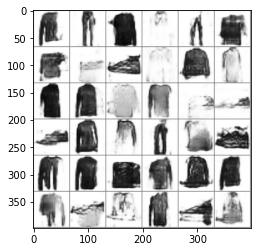

Epochs :  15  Step :  14400  Generator Loss :  0.6385661428504358  Critic Loss :  -1.255036841919977


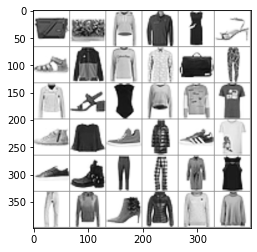

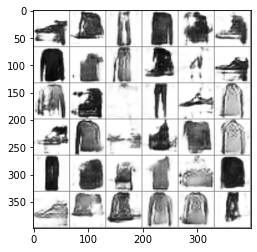

Epochs :  15  Step :  14500  Generator Loss :  0.6379493537907296  Critic Loss :  -1.253433747250581


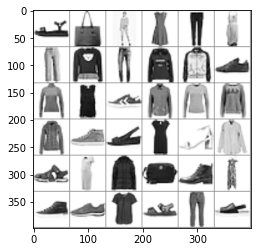

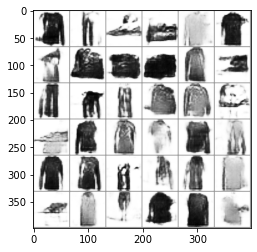

Epochs :  15  Step :  14600  Generator Loss :  0.6375719334211117  Critic Loss :  -1.2528460845609635


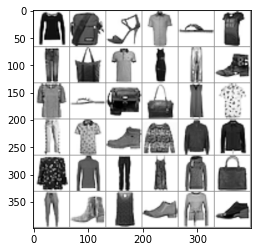

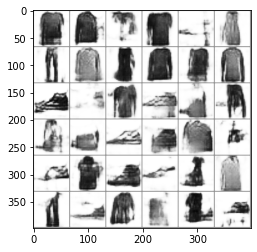

Epochs :  15  Step :  14700  Generator Loss :  0.6370178210866309  Critic Loss :  -1.2516503476501726


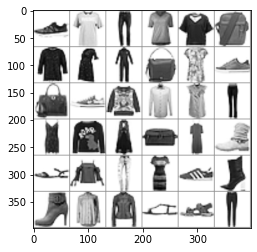

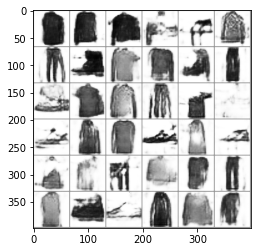

Epochs :  15  Step :  14800  Generator Loss :  0.6364633736615164  Critic Loss :  -1.250569545752415


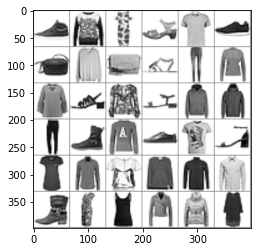

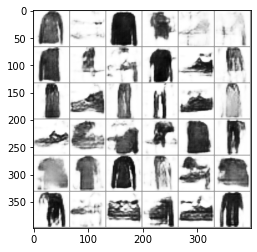

Epochs :  15  Step :  14900  Generator Loss :  0.6361270461685724  Critic Loss :  -1.2497203726085653


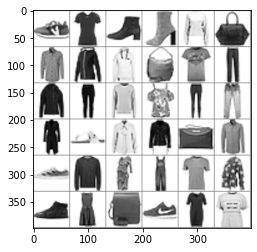

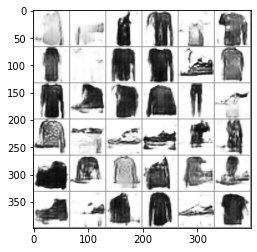

Epochs :  15  Step :  15000  Generator Loss :  0.635649552610439  Critic Loss :  -1.2489433619635513


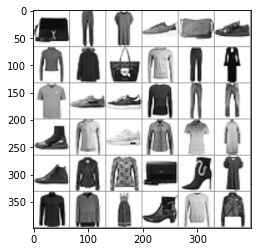

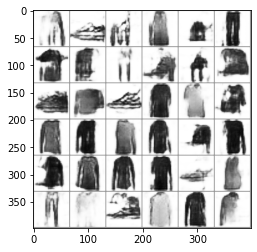

Epochs :  16  Step :  15100  Generator Loss :  0.6350709539392057  Critic Loss :  -1.2481724512515082


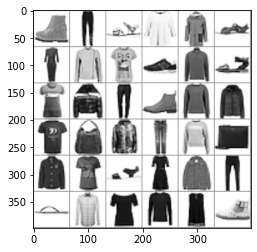

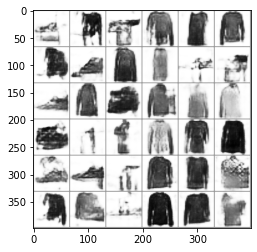

Epochs :  16  Step :  15200  Generator Loss :  0.6346085610259539  Critic Loss :  -1.2469919973381638


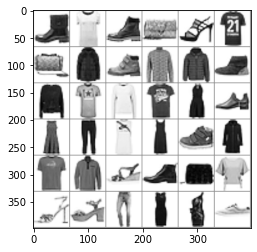

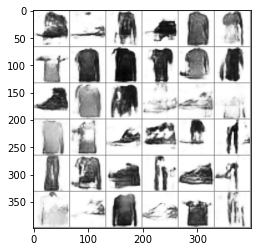

Epochs :  16  Step :  15300  Generator Loss :  0.6340412249667052  Critic Loss :  -1.2458337277858842


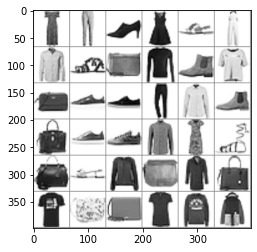

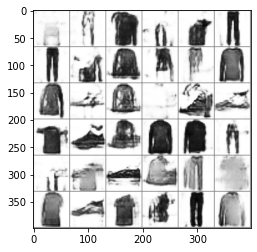

Epochs :  16  Step :  15400  Generator Loss :  0.6337490279417539  Critic Loss :  -1.2454248309884535


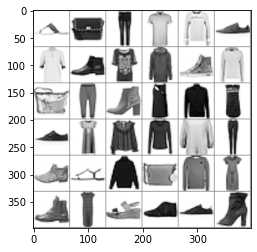

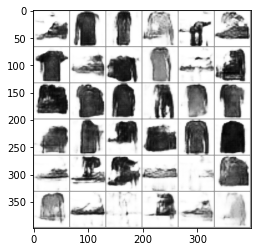

Epochs :  16  Step :  15500  Generator Loss :  0.6331215992487156  Critic Loss :  -1.2441402421822636


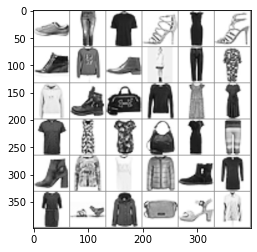

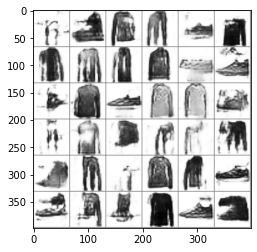

Epochs :  16  Step :  15600  Generator Loss :  0.6313371283111001  Critic Loss :  -1.240341701270502


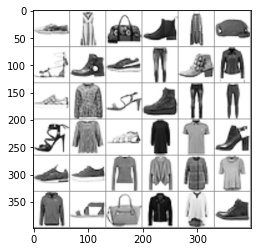

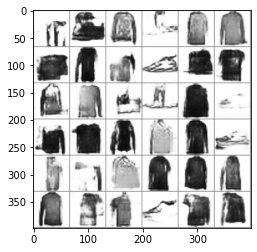

Epochs :  16  Step :  15700  Generator Loss :  0.6310120264865654  Critic Loss :  -1.2398047889985628


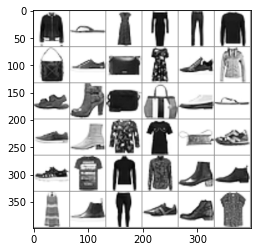

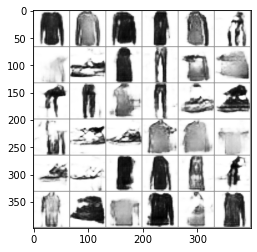

Epochs :  16  Step :  15800  Generator Loss :  0.6305667898806454  Critic Loss :  -1.2390410548329875


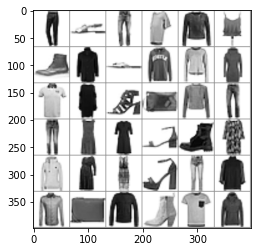

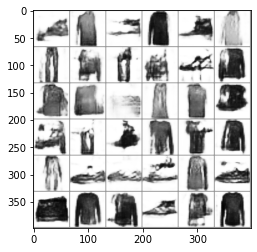

Epochs :  16  Step :  15900  Generator Loss :  0.6303478493019148  Critic Loss :  -1.2387336590517017


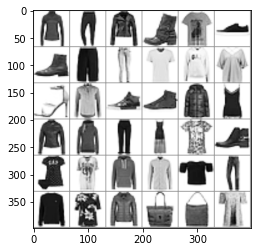

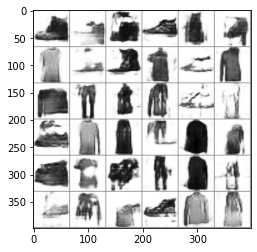

Epochs :  17  Step :  16000  Generator Loss :  0.6287708909635112  Critic Loss :  -1.235333983687699


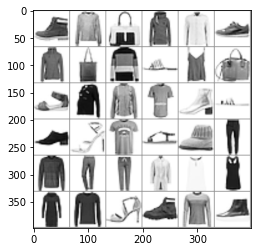

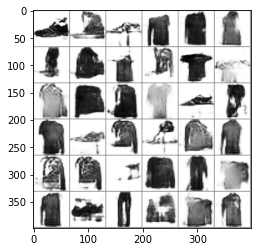

Epochs :  17  Step :  16100  Generator Loss :  0.6281813257724561  Critic Loss :  -1.2342253555764835


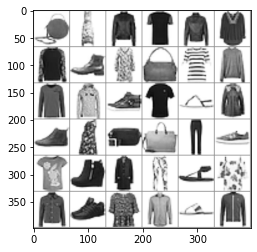

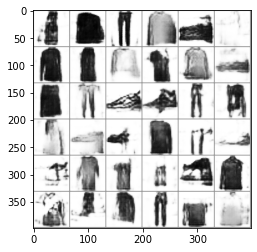

Epochs :  17  Step :  16200  Generator Loss :  0.6277816050168684  Critic Loss :  -1.2332239792485074


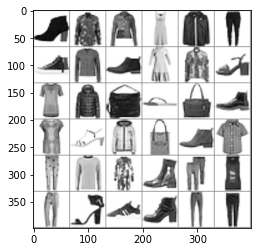

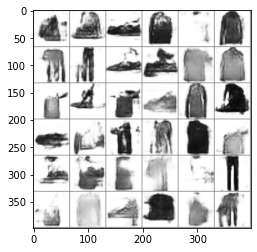

Epochs :  17  Step :  16300  Generator Loss :  0.6272026222014223  Critic Loss :  -1.2324689275002696


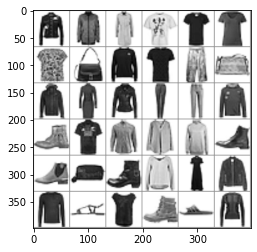

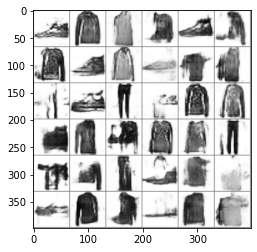

Epochs :  17  Step :  16400  Generator Loss :  0.6269101282011678  Critic Loss :  -1.2320078732137056


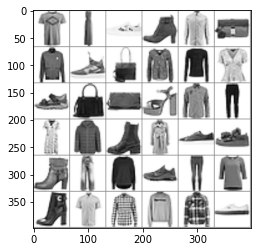

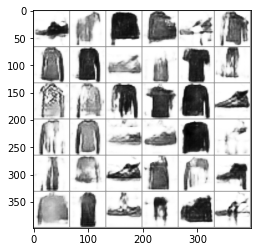

Epochs :  17  Step :  16500  Generator Loss :  0.6265427249560669  Critic Loss :  -1.2311511248030595


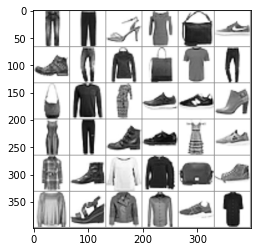

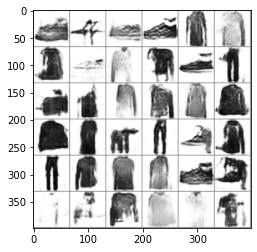

Epochs :  17  Step :  16600  Generator Loss :  0.6264600789191409  Critic Loss :  -1.230931946806759


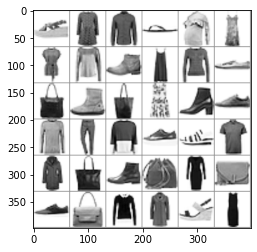

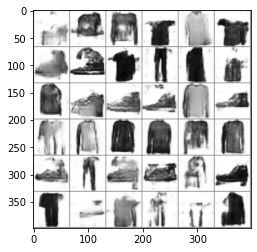

Epochs :  17  Step :  16700  Generator Loss :  0.6261744611019765  Critic Loss :  -1.2304541465310515


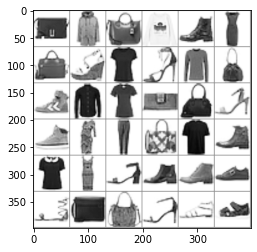

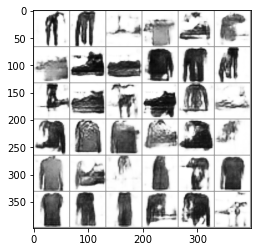

Epochs :  17  Step :  16800  Generator Loss :  0.6258538163987604  Critic Loss :  -1.2298384537649527


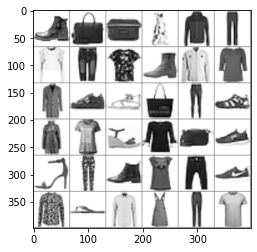

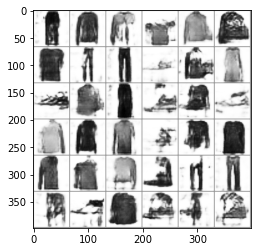

Epochs :  18  Step :  16900  Generator Loss :  0.6256338830083228  Critic Loss :  -1.2292983088620013


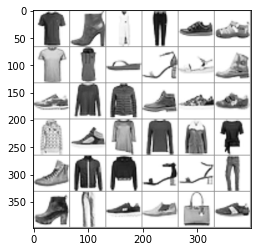

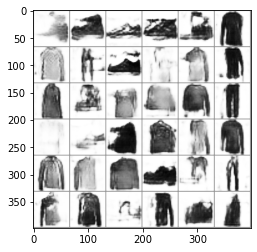

Epochs :  18  Step :  17000  Generator Loss :  0.6255439145575304  Critic Loss :  -1.229212829825032


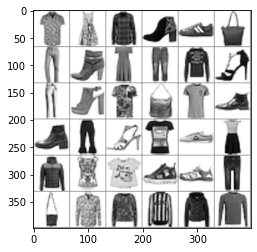

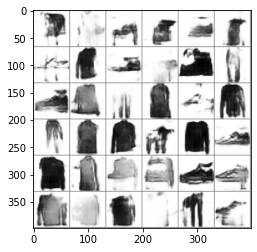

Epochs :  18  Step :  17100  Generator Loss :  0.6249452205285926  Critic Loss :  -1.2278237076782648


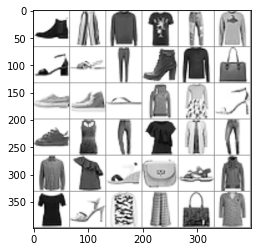

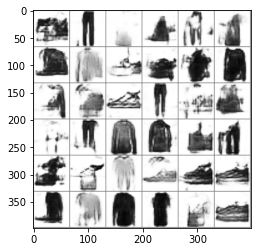

Epochs :  18  Step :  17200  Generator Loss :  0.6242380760203327  Critic Loss :  -1.226228522167402


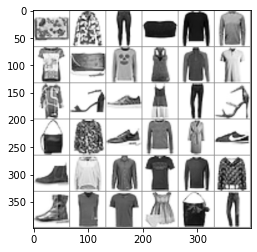

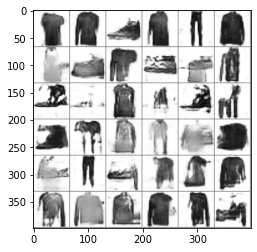

Epochs :  18  Step :  17300  Generator Loss :  0.6236228992542753  Critic Loss :  -1.224984451161052


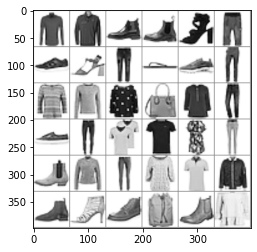

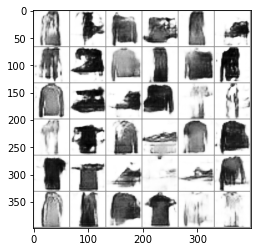

Epochs :  18  Step :  17400  Generator Loss :  0.6237699543263351  Critic Loss :  -1.2253045701044671


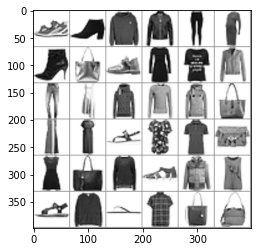

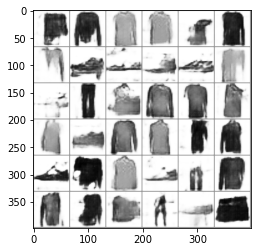

Epochs :  18  Step :  17500  Generator Loss :  0.6236754429349277  Critic Loss :  -1.2252428202054442


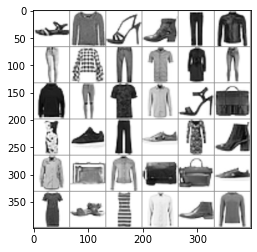

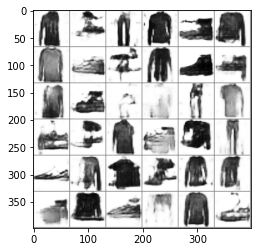

Epochs :  18  Step :  17600  Generator Loss :  0.6237903987908794  Critic Loss :  -1.2255505239177102


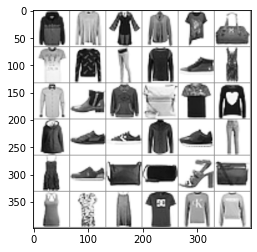

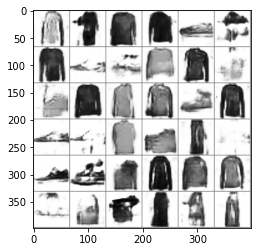

Epochs :  18  Step :  17700  Generator Loss :  0.6240979642850757  Critic Loss :  -1.2262863689471721


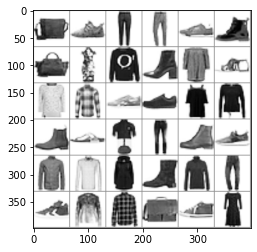

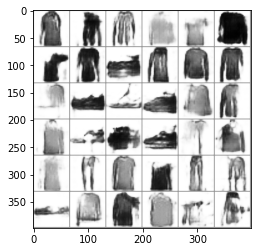

Epochs :  18  Step :  17800  Generator Loss :  0.6245298899735685  Critic Loss :  -1.227237796473632


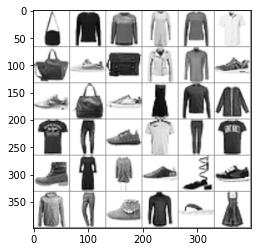

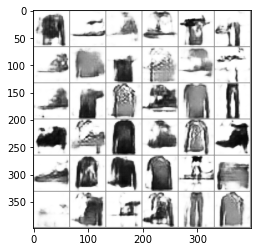

Epochs :  19  Step :  17900  Generator Loss :  0.6248265988142854  Critic Loss :  -1.2279472445651771


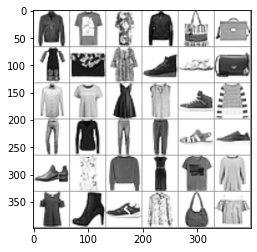

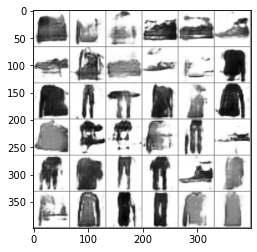

Epochs :  19  Step :  18000  Generator Loss :  0.6252703490729521  Critic Loss :  -1.228719140995803


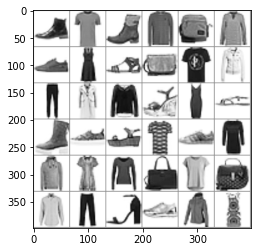

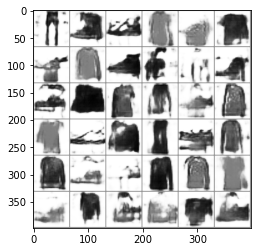

Epochs :  19  Step :  18100  Generator Loss :  0.6256158916644355  Critic Loss :  -1.2297406885777997


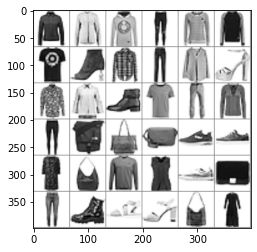

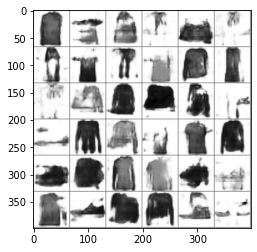

Epochs :  19  Step :  18200  Generator Loss :  0.6259716425754596  Critic Loss :  -1.2305296632561673


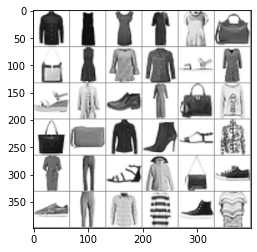

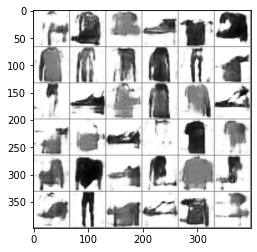

Epochs :  19  Step :  18300  Generator Loss :  0.6263253129929522  Critic Loss :  -1.2313695132829419


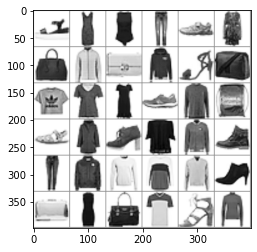

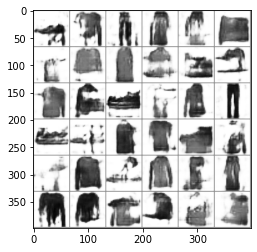

Epochs :  19  Step :  18400  Generator Loss :  0.6266573385910875  Critic Loss :  -1.232218713722731


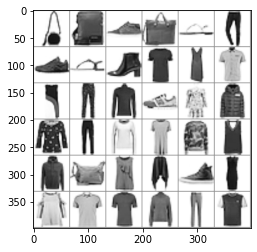

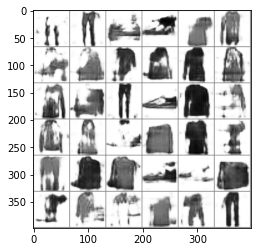

Epochs :  19  Step :  18500  Generator Loss :  0.6270672421224188  Critic Loss :  -1.2334521110701524


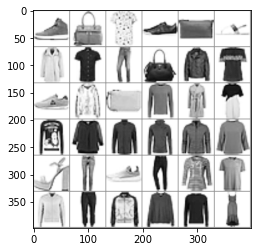

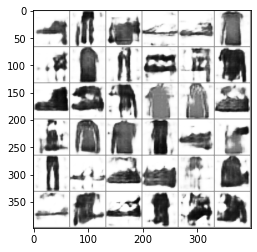

Epochs :  19  Step :  18600  Generator Loss :  0.6274016038072421  Critic Loss :  -1.2342861531497928


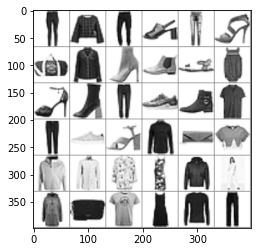

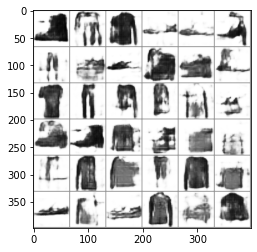

Epochs :  19  Step :  18700  Generator Loss :  0.6278523817937697  Critic Loss :  -1.235303970127114


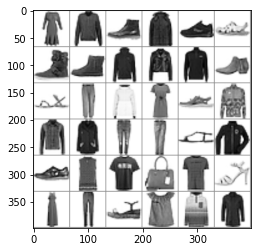

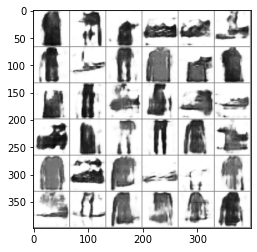

Epochs :  20  Step :  18800  Generator Loss :  0.6282656940551687  Critic Loss :  -1.2365246501925735


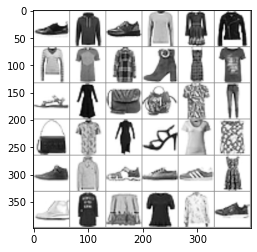

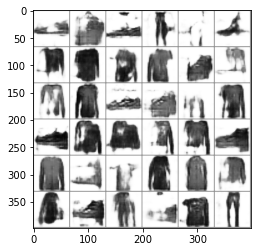

Epochs :  20  Step :  18900  Generator Loss :  0.6287759496708568  Critic Loss :  -1.237654458217768


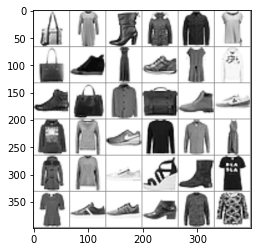

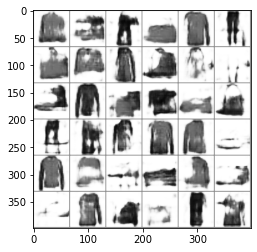

Epochs :  20  Step :  19000  Generator Loss :  0.6292417457828567  Critic Loss :  -1.2388134477012351


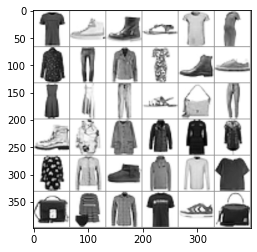

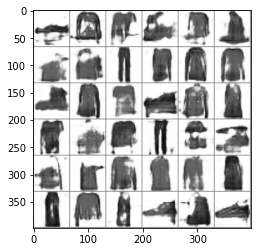

Epochs :  20  Step :  19100  Generator Loss :  0.6297274867280787  Critic Loss :  -1.2399641686330864


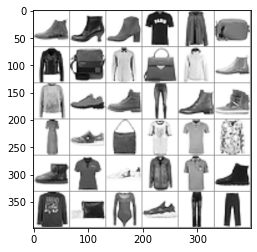

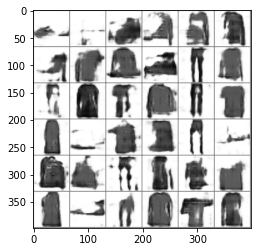

Epochs :  20  Step :  19200  Generator Loss :  0.6302144364208774  Critic Loss :  -1.2409357538961456


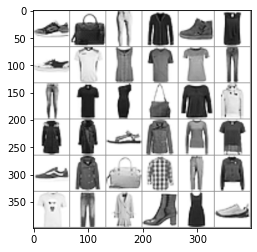

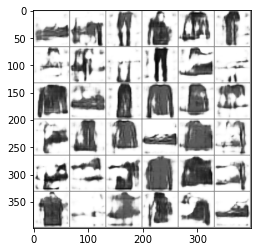

Epochs :  20  Step :  19300  Generator Loss :  0.6304965619784731  Critic Loss :  -1.241642892457596


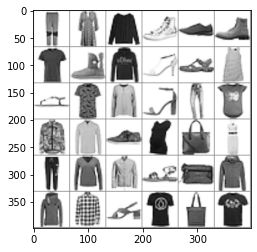

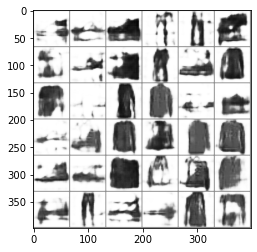

Epochs :  20  Step :  19400  Generator Loss :  0.6310040058459986  Critic Loss :  -1.2427568084341944


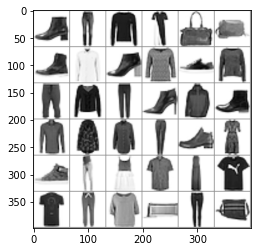

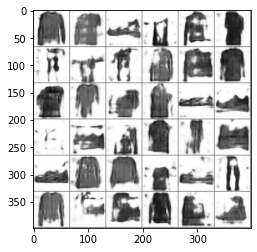

Epochs :  20  Step :  19500  Generator Loss :  0.6314494358155375  Critic Loss :  -1.2438831137534276


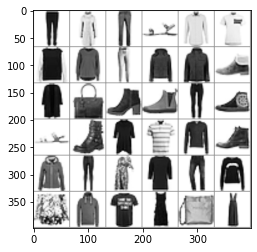

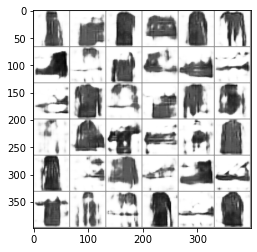

Epochs :  20  Step :  19600  Generator Loss :  0.6319590417545987  Critic Loss :  -1.2450489502913475


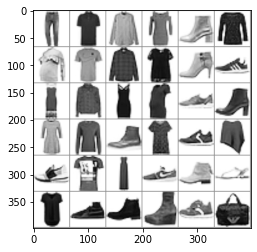

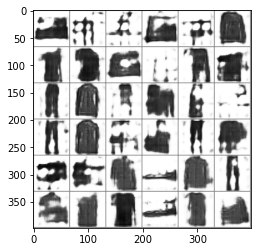

Epochs :  21  Step :  19700  Generator Loss :  0.6324197011702306  Critic Loss :  -1.2460425824794668


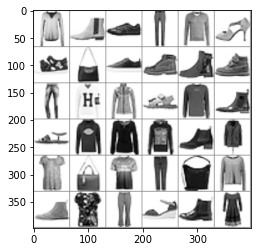

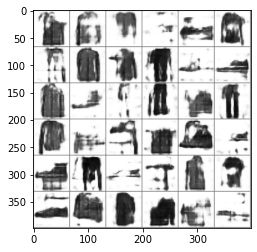

Epochs :  21  Step :  19800  Generator Loss :  0.6329113670070114  Critic Loss :  -1.2471334230992515


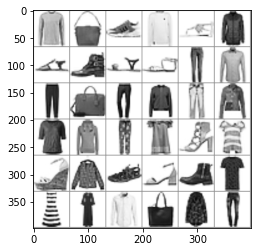

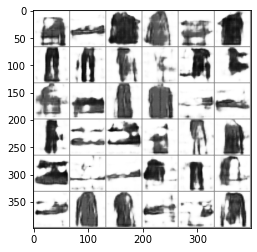

Epochs :  21  Step :  19900  Generator Loss :  0.633414346156443  Critic Loss :  -1.248303686931742


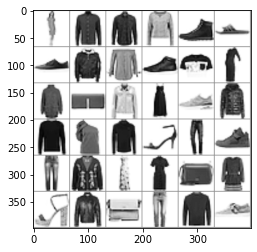

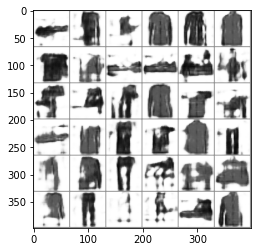

Epochs :  21  Step :  20000  Generator Loss :  0.6338444914069375  Critic Loss :  -1.2494617813971016


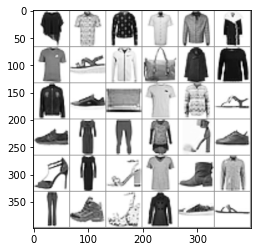

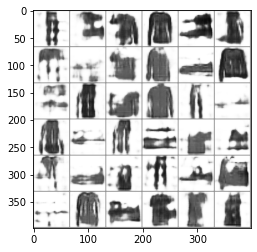

Epochs :  21  Step :  20100  Generator Loss :  0.6342068042584222  Critic Loss :  -1.2504315183493455


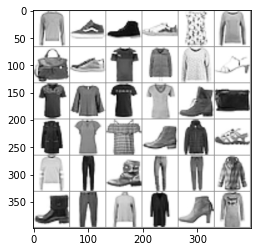

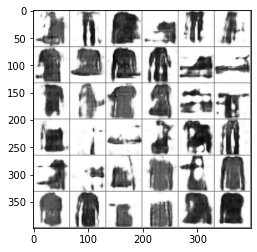

Epochs :  21  Step :  20200  Generator Loss :  0.6345698262201875  Critic Loss :  -1.2513903860235984


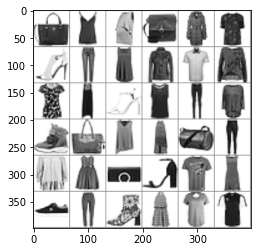

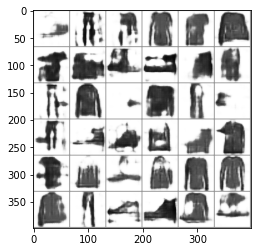

Epochs :  21  Step :  20300  Generator Loss :  0.6351504709916946  Critic Loss :  -1.2527570878183725


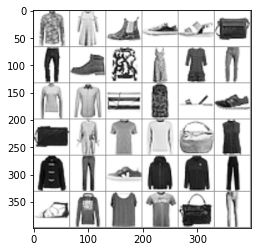

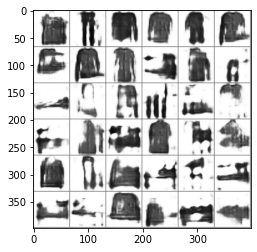

Epochs :  21  Step :  20400  Generator Loss :  0.6355941010423931  Critic Loss :  -1.2539108499260911


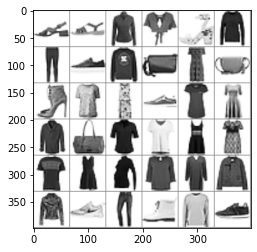

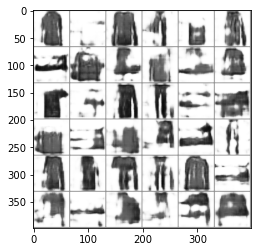

Epochs :  21  Step :  20500  Generator Loss :  0.6360059451446641  Critic Loss :  -1.2549561629558585


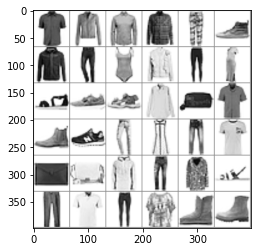

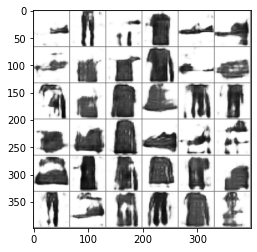

Epochs :  21  Step :  20600  Generator Loss :  0.6363662769884499  Critic Loss :  -1.255936343195813


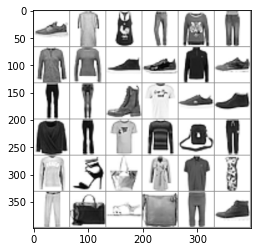

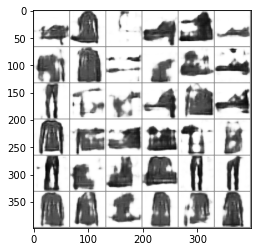

Epochs :  22  Step :  20700  Generator Loss :  0.6367259815911501  Critic Loss :  -1.2569775583005574


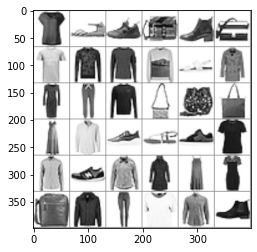

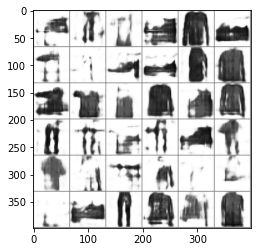

Epochs :  22  Step :  20800  Generator Loss :  0.6371760692777305  Critic Loss :  -1.2581486031795737


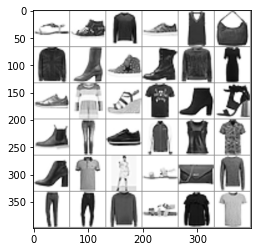

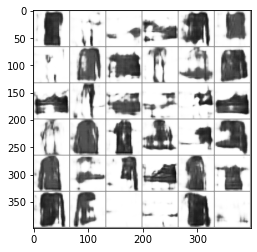

Epochs :  22  Step :  20900  Generator Loss :  0.6376249568300147  Critic Loss :  -1.2592753502177663


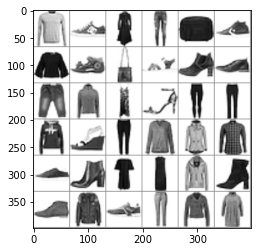

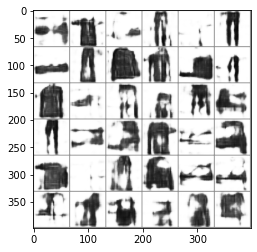

Epochs :  22  Step :  21000  Generator Loss :  0.6380336864225987  Critic Loss :  -1.2602396946624737


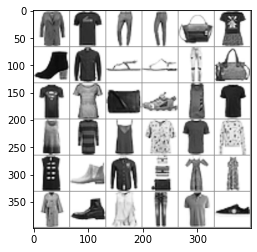

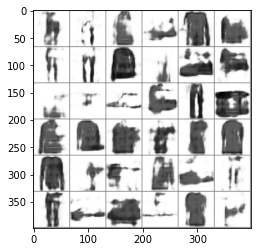

Epochs :  22  Step :  21100  Generator Loss :  0.638592526548712  Critic Loss :  -1.2615480325347823


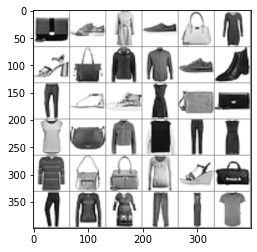

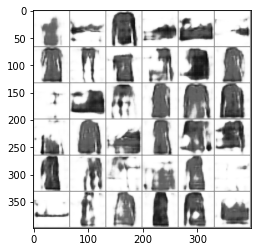

Epochs :  22  Step :  21200  Generator Loss :  0.6389497019874947  Critic Loss :  -1.2624314424849716


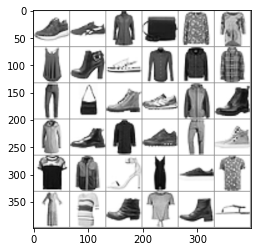

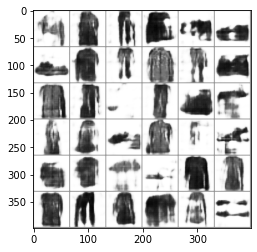

Epochs :  22  Step :  21300  Generator Loss :  0.6393342530304903  Critic Loss :  -1.263280419587958


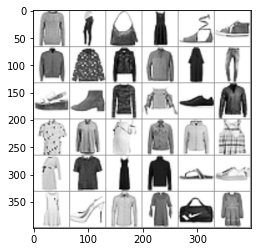

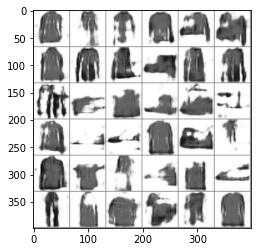

Epochs :  22  Step :  21400  Generator Loss :  0.6397809558554017  Critic Loss :  -1.264448104229077


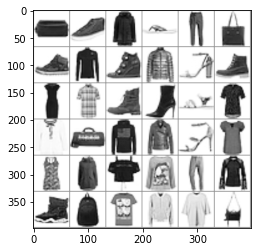

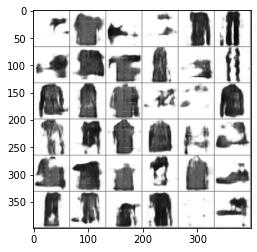

Epochs :  22  Step :  21500  Generator Loss :  0.6401795763419184  Critic Loss :  -1.2652085822883132


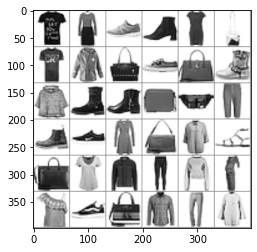

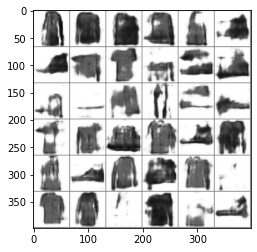

Epochs :  23  Step :  21600  Generator Loss :  0.6404664851225701  Critic Loss :  -1.2660530250998376


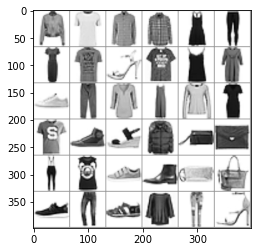

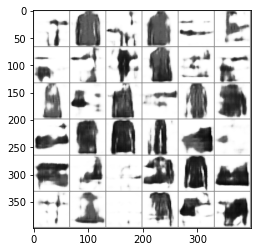

Epochs :  23  Step :  21700  Generator Loss :  0.6407994543246749  Critic Loss :  -1.2666564989415545


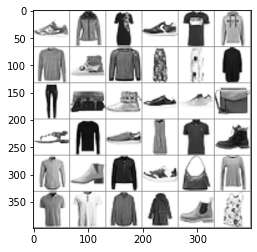

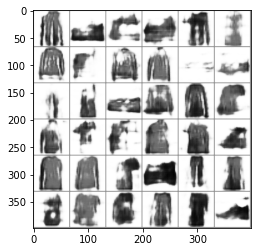

Epochs :  23  Step :  21800  Generator Loss :  0.6412445953137075  Critic Loss :  -1.2677565223239793


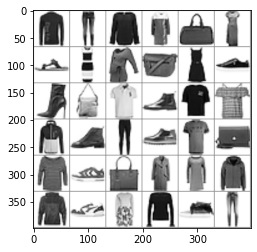

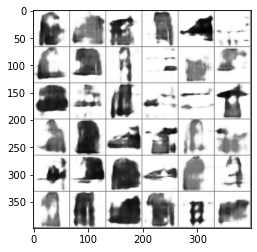

Epochs :  23  Step :  21900  Generator Loss :  0.6416090926940374  Critic Loss :  -1.2686887724019973


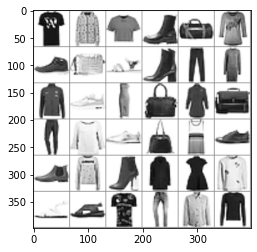

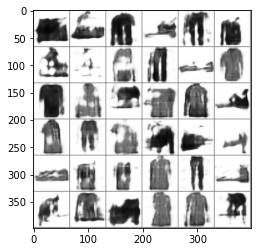

Epochs :  23  Step :  22000  Generator Loss :  0.6420422135839472  Critic Loss :  -1.2696679430055413


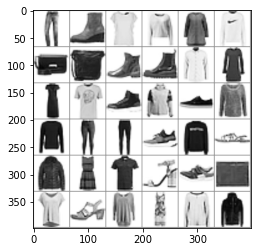

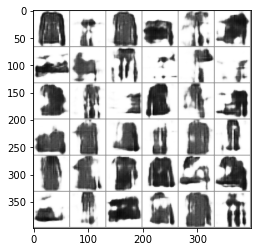

Epochs :  23  Step :  22100  Generator Loss :  0.6423666387466752  Critic Loss :  -1.2704965271374016


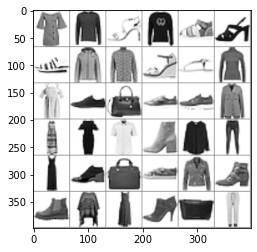

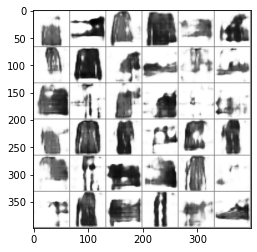

Epochs :  23  Step :  22200  Generator Loss :  0.6427020940242382  Critic Loss :  -1.2715389959051067


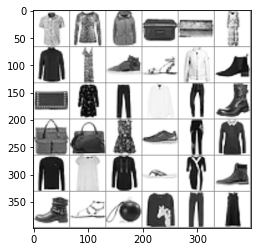

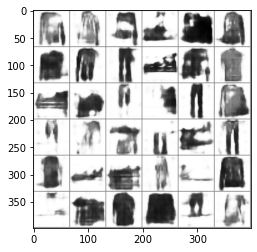

Epochs :  23  Step :  22300  Generator Loss :  0.643098160170192  Critic Loss :  -1.2723516878185053


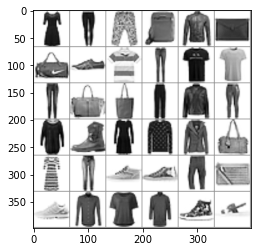

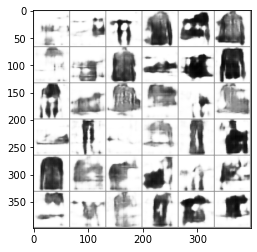

Epochs :  23  Step :  22400  Generator Loss :  0.6434704004807593  Critic Loss :  -1.2731482200041218


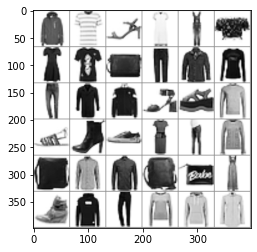

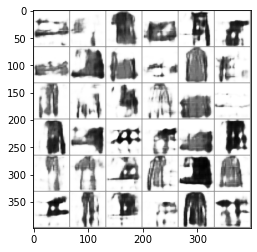

Epochs :  23  Step :  22500  Generator Loss :  0.6439109868467578  Critic Loss :  -1.2742482330959441


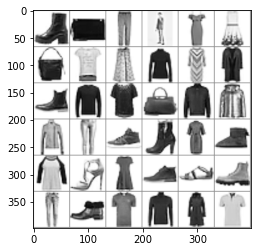

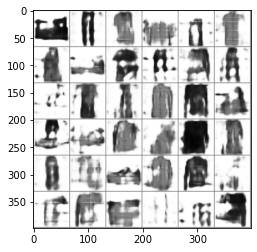

Epochs :  24  Step :  22600  Generator Loss :  0.6441305447634272  Critic Loss :  -1.2748145841666103


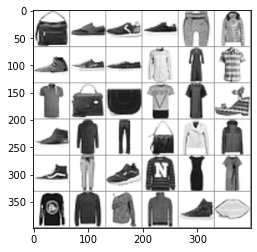

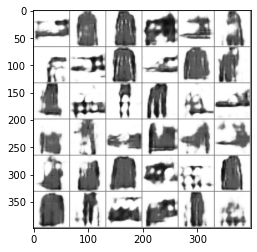

Epochs :  24  Step :  22700  Generator Loss :  0.6445191186017332  Critic Loss :  -1.2755629356311877


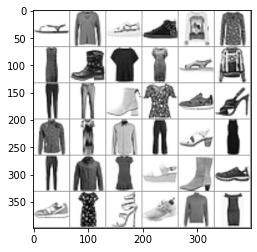

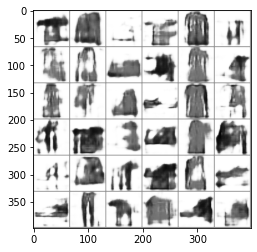

Epochs :  24  Step :  22800  Generator Loss :  0.6448531029426406  Critic Loss :  -1.276380673645888


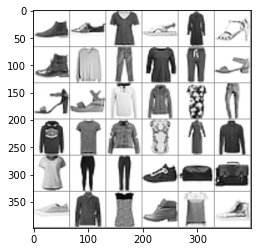

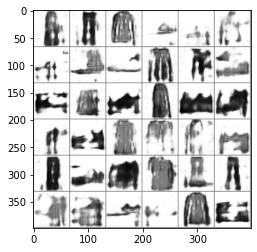

Epochs :  24  Step :  22900  Generator Loss :  0.6451084114009957  Critic Loss :  -1.277075365958262


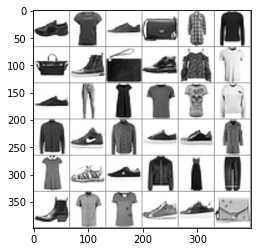

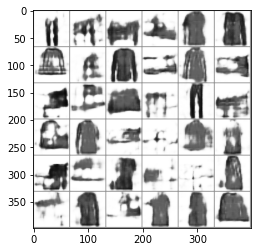

Epochs :  24  Step :  23000  Generator Loss :  0.645411117662949  Critic Loss :  -1.2777762760724767


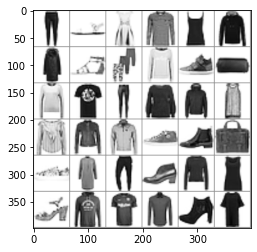

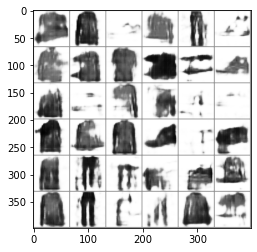

Epochs :  24  Step :  23100  Generator Loss :  0.6458032652081668  Critic Loss :  -1.2785639856615163


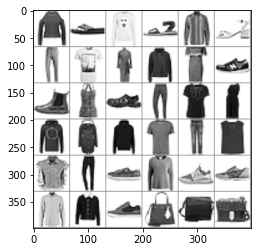

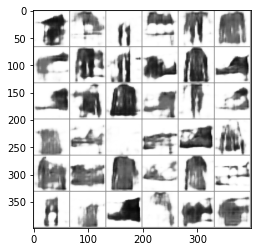

Epochs :  24  Step :  23200  Generator Loss :  0.6461987570561529  Critic Loss :  -1.2794050523001623


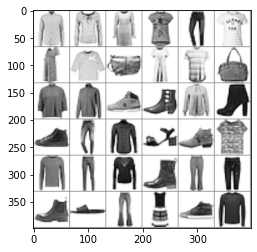

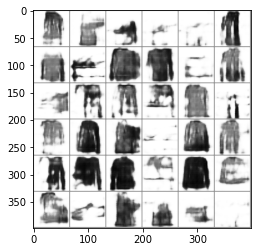

Epochs :  24  Step :  23300  Generator Loss :  0.6465565352446335  Critic Loss :  -1.2801590520230537


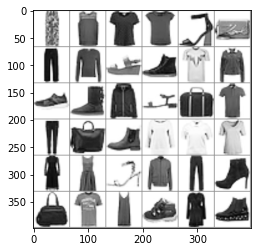

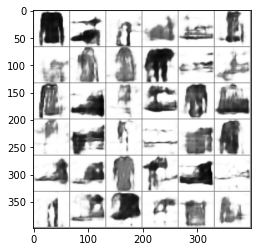

Epochs :  24  Step :  23400  Generator Loss :  0.64686641560954  Critic Loss :  -1.280688173695513


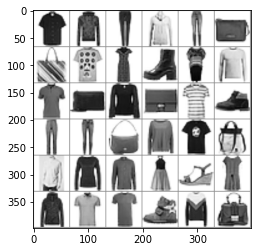

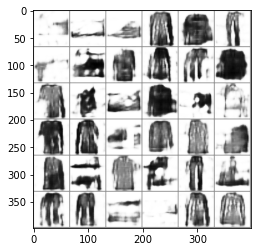

Epochs :  25  Step :  23500  Generator Loss :  0.6471222881805448  Critic Loss :  -1.2811984695855663


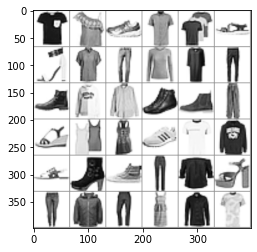

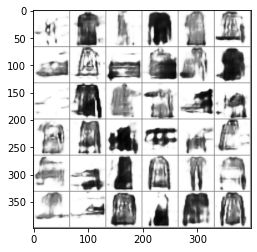

Epochs :  25  Step :  23600  Generator Loss :  0.6473735464134518  Critic Loss :  -1.2818851861451197


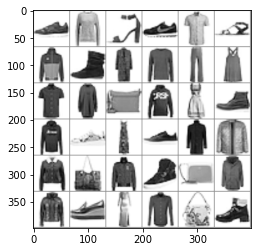

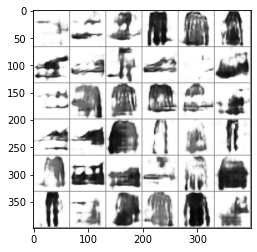

Epochs :  25  Step :  23700  Generator Loss :  0.6476060633714122  Critic Loss :  -1.2825239898881895


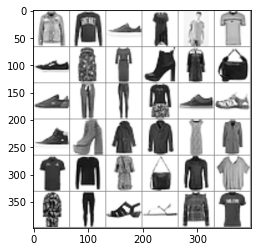

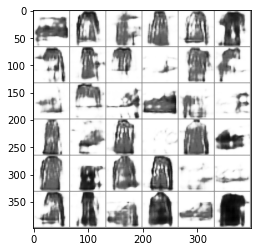

Epochs :  25  Step :  23800  Generator Loss :  0.647857461017038  Critic Loss :  -1.2831277565162282


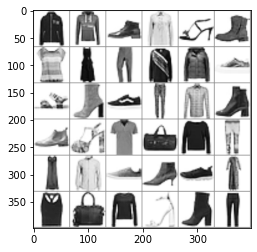

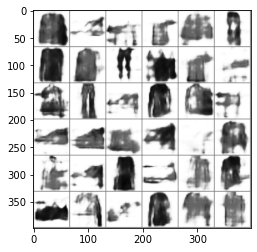

Epochs :  25  Step :  23900  Generator Loss :  0.6482088130875295  Critic Loss :  -1.2839818836305994


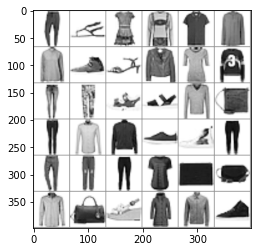

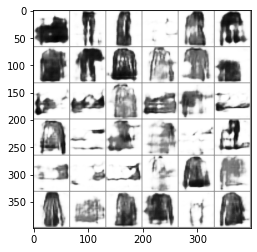

Epochs :  25  Step :  24000  Generator Loss :  0.6484107817821884  Critic Loss :  -1.2842682872444453


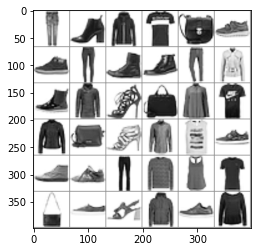

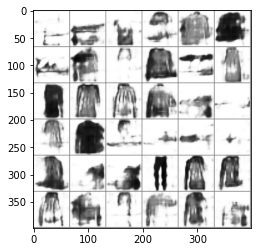

Epochs :  25  Step :  24100  Generator Loss :  0.6486366984533258  Critic Loss :  -1.284791789002197


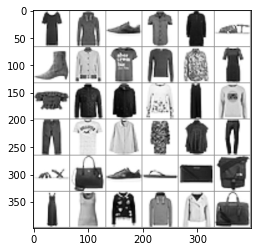

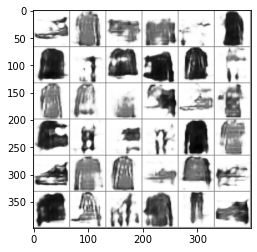

Epochs :  25  Step :  24200  Generator Loss :  0.6488322021902158  Critic Loss :  -1.2855158468183223


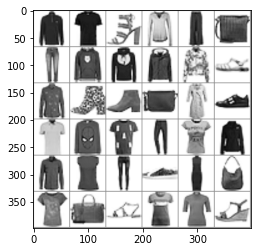

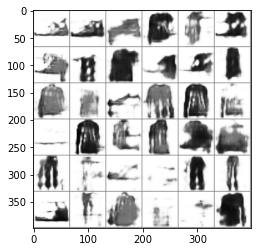

Epochs :  25  Step :  24300  Generator Loss :  0.6489821624361005  Critic Loss :  -1.28594248690098


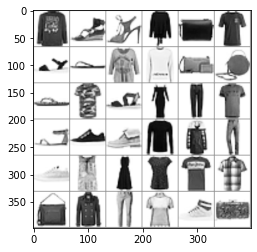

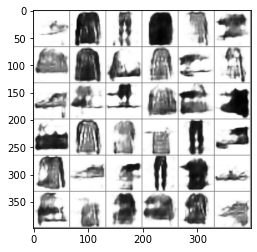

Epochs :  26  Step :  24400  Generator Loss :  0.6492984348777433  Critic Loss :  -1.2867047914255643


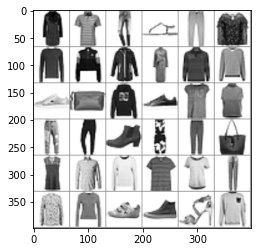

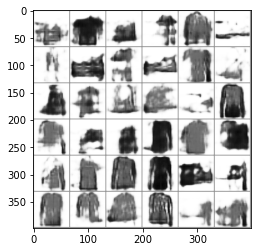

Epochs :  26  Step :  24500  Generator Loss :  0.6495420268310937  Critic Loss :  -1.2872522710509486


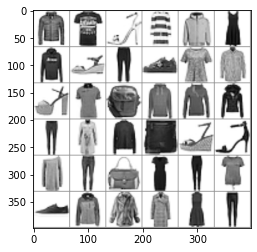

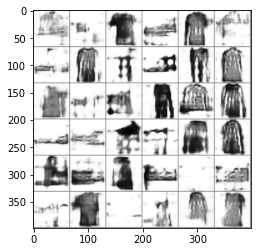

Epochs :  26  Step :  24600  Generator Loss :  0.649761448987046  Critic Loss :  -1.2876260218892925


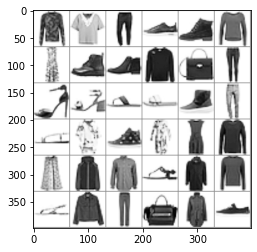

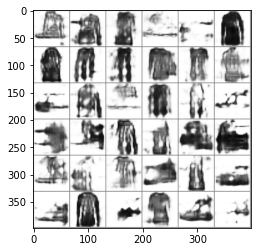

Epochs :  26  Step :  24700  Generator Loss :  0.6499609406215048  Critic Loss :  -1.2878984813611802


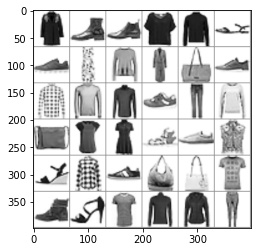

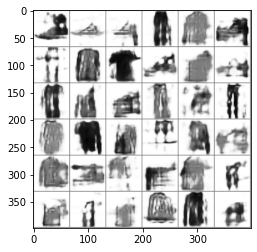

Epochs :  26  Step :  24800  Generator Loss :  0.6503027517565868  Critic Loss :  -1.2886571450938897


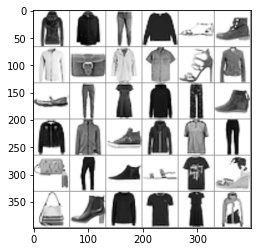

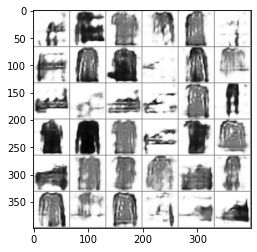

Epochs :  26  Step :  24900  Generator Loss :  0.6505731060898519  Critic Loss :  -1.2892187717208703


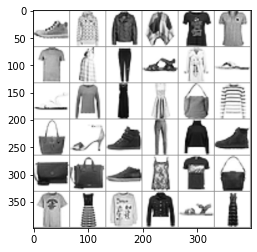

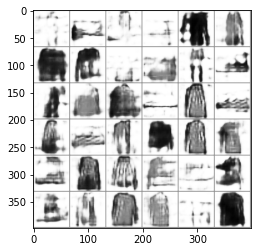

Epochs :  26  Step :  25000  Generator Loss :  0.6507358218799065  Critic Loss :  -1.2897463547917647


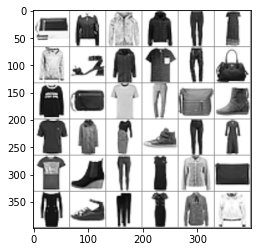

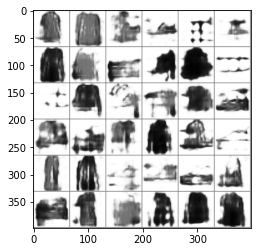

Epochs :  26  Step :  25100  Generator Loss :  0.6509651917763392  Critic Loss :  -1.2903605230316504


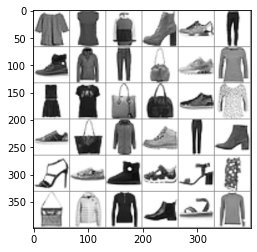

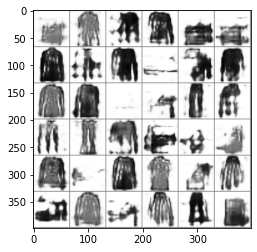

Epochs :  26  Step :  25200  Generator Loss :  0.6511448613315772  Critic Loss :  -1.2907727206258364


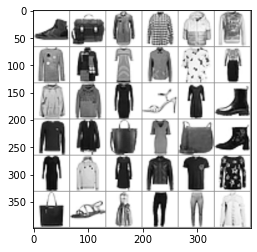

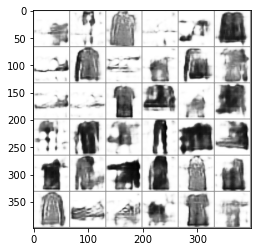

Epochs :  26  Step :  25300  Generator Loss :  0.6514436738674065  Critic Loss :  -1.2914479244621186


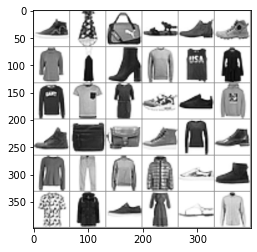

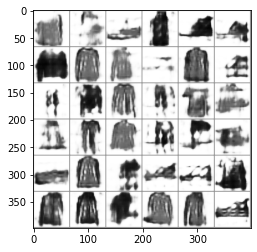

Epochs :  27  Step :  25400  Generator Loss :  0.6515716814719357  Critic Loss :  -1.2917397614610755


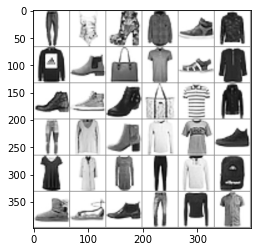

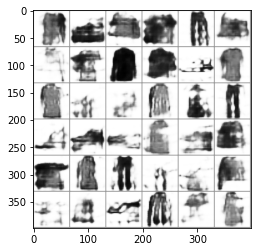

Epochs :  27  Step :  25500  Generator Loss :  0.6517715226511435  Critic Loss :  -1.2920905213192435


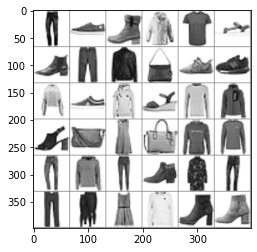

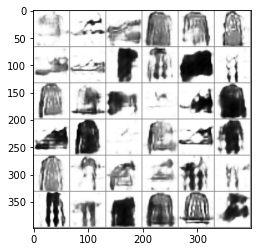

Epochs :  27  Step :  25600  Generator Loss :  0.652008833207683  Critic Loss :  -1.2925758190942034


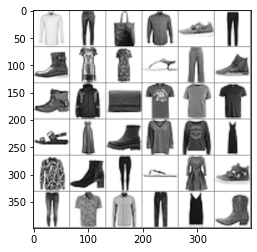

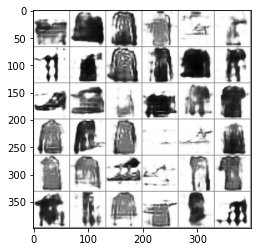

Epochs :  27  Step :  25700  Generator Loss :  0.6521762532552664  Critic Loss :  -1.2925874947346634


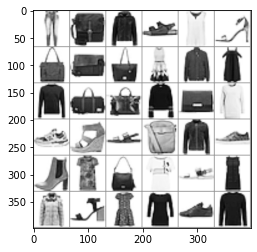

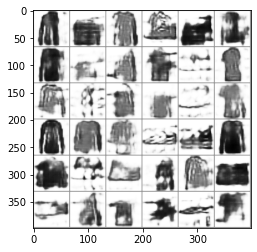

Epochs :  27  Step :  25800  Generator Loss :  0.6523311603577833  Critic Loss :  -1.2929118329176874


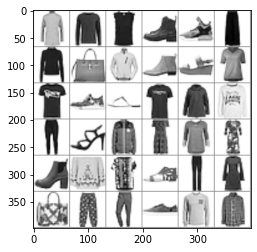

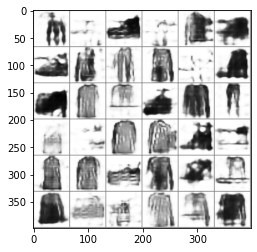

Epochs :  27  Step :  25900  Generator Loss :  0.6524428548457724  Critic Loss :  -1.2929965915294495


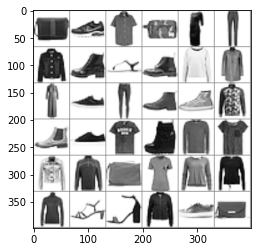

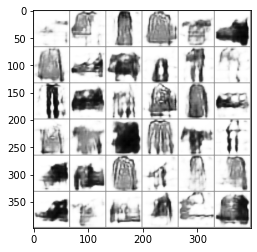

Epochs :  27  Step :  26000  Generator Loss :  0.6526047008135983  Critic Loss :  -1.2934704735502622


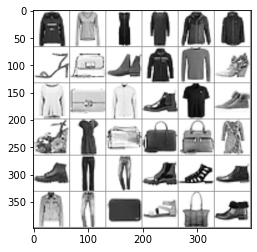

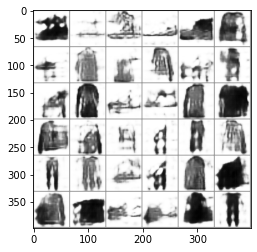

Epochs :  27  Step :  26100  Generator Loss :  0.6526408753534726  Critic Loss :  -1.2937073525812695


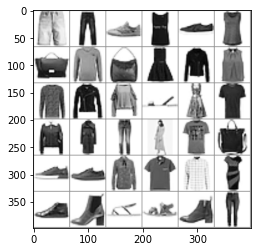

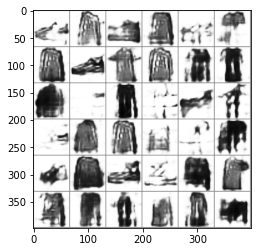

Epochs :  27  Step :  26200  Generator Loss :  0.6526590594534766  Critic Loss :  -1.2937420700266418


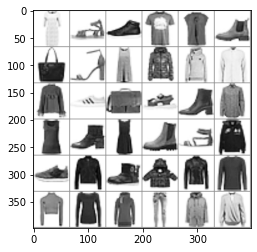

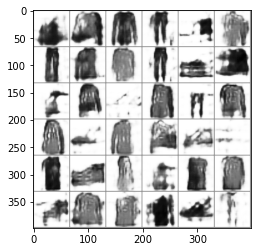

Epochs :  28  Step :  26300  Generator Loss :  0.6527197409808518  Critic Loss :  -1.293892024360571


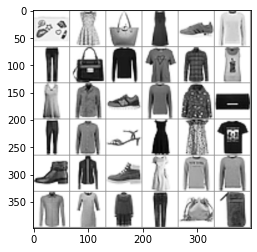

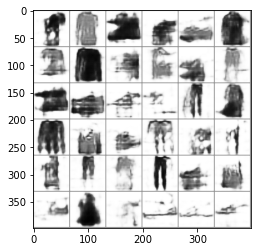

Epochs :  28  Step :  26400  Generator Loss :  0.6528369872700194  Critic Loss :  -1.2941887845641145


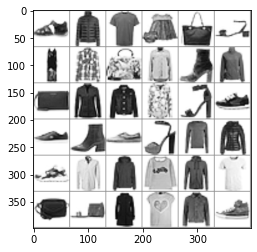

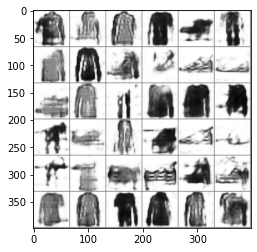

Epochs :  28  Step :  26500  Generator Loss :  0.6529186868340673  Critic Loss :  -1.2941917120708937


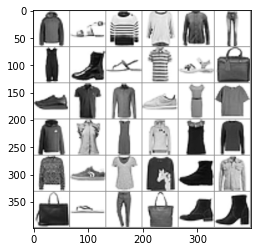

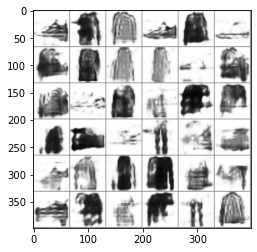

Epochs :  28  Step :  26600  Generator Loss :  0.6528795827711543  Critic Loss :  -1.2942489104281363


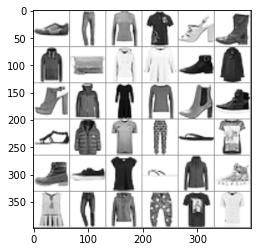

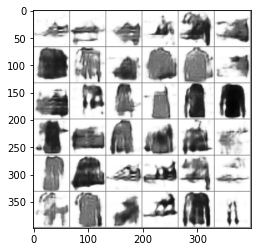

Epochs :  28  Step :  26700  Generator Loss :  0.6529821192716555  Critic Loss :  -1.2946089414118502


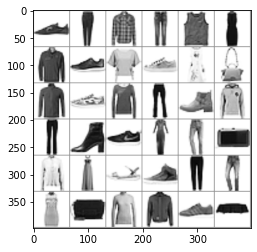

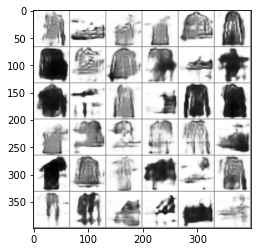

Epochs :  28  Step :  26800  Generator Loss :  0.6531119762319957  Critic Loss :  -1.2948798281092602


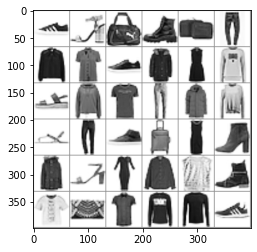

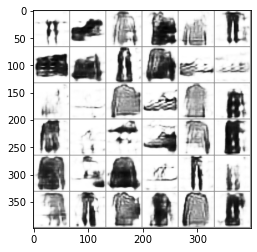

Epochs :  28  Step :  26900  Generator Loss :  0.6532077418982578  Critic Loss :  -1.295004088546632


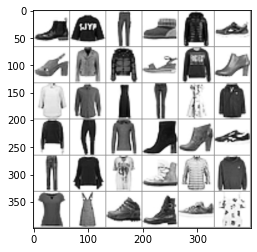

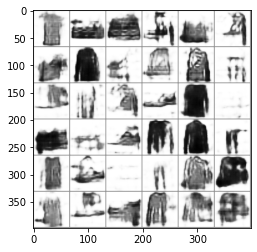

Epochs :  28  Step :  27000  Generator Loss :  0.6533344538079626  Critic Loss :  -1.295228278437292


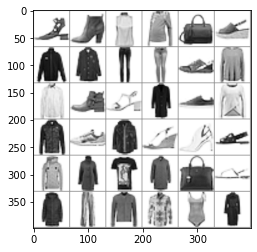

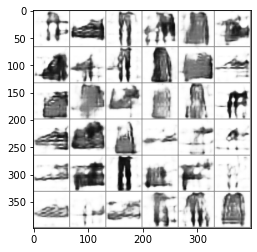

Epochs :  28  Step :  27100  Generator Loss :  0.6534026602097801  Critic Loss :  -1.2952441123208571


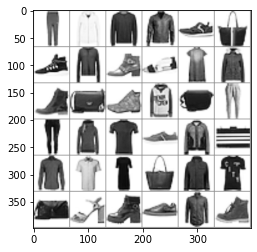

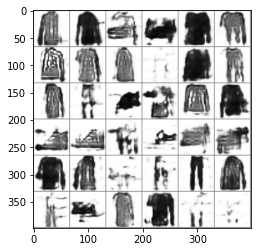

Epochs :  28  Step :  27200  Generator Loss :  0.6535135828854554  Critic Loss :  -1.295387107010637


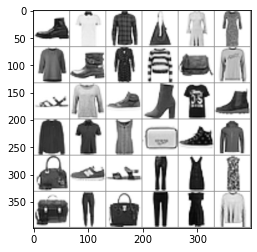

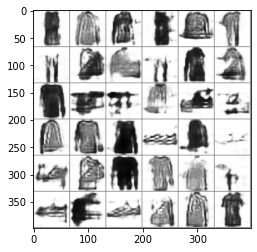

Epochs :  29  Step :  27300  Generator Loss :  0.6536667508528493  Critic Loss :  -1.2958794097399668


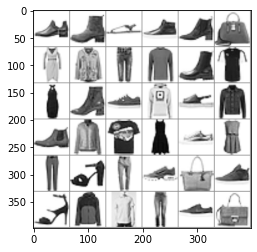

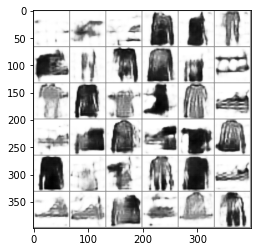

Epochs :  29  Step :  27400  Generator Loss :  0.6536968560465425  Critic Loss :  -1.2960119151666993


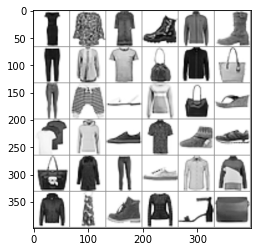

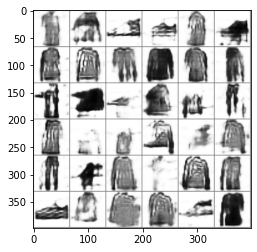

Epochs :  29  Step :  27500  Generator Loss :  0.6538176199184477  Critic Loss :  -1.2963604548870773


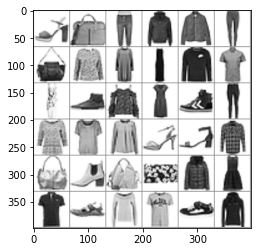

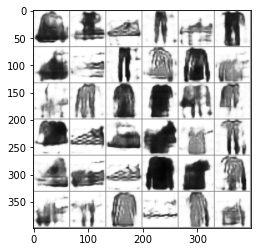

Epochs :  29  Step :  27600  Generator Loss :  0.6538247250560317  Critic Loss :  -1.2964035022792524


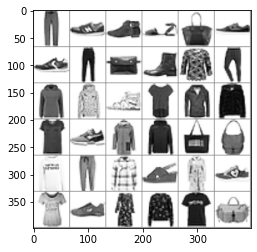

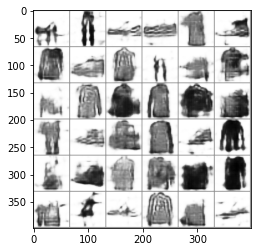

Epochs :  29  Step :  27700  Generator Loss :  0.65383764190659  Critic Loss :  -1.296505769491661


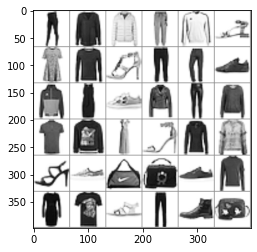

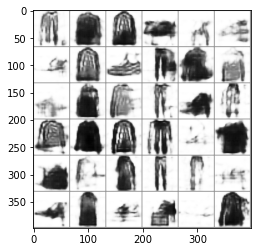

Epochs :  29  Step :  27800  Generator Loss :  0.6539235424587299  Critic Loss :  -1.296745986589675


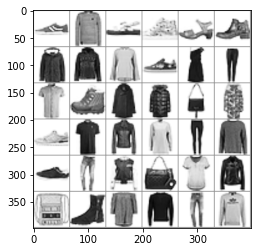

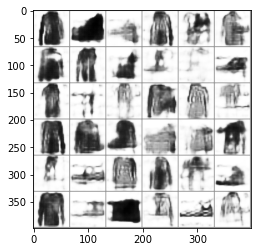

Epochs :  29  Step :  27900  Generator Loss :  0.6538979524034109  Critic Loss :  -1.296929788475431


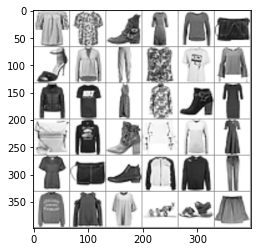

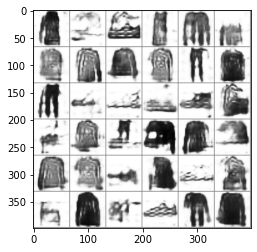

Epochs :  29  Step :  28000  Generator Loss :  0.6538121704204324  Critic Loss :  -1.2967215344840222


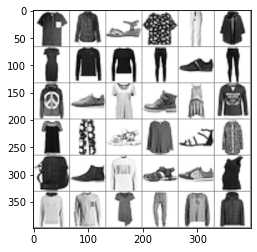

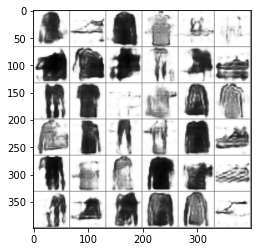

Epochs :  29  Step :  28100  Generator Loss :  0.6537411078706871  Critic Loss :  -1.2966239088958633


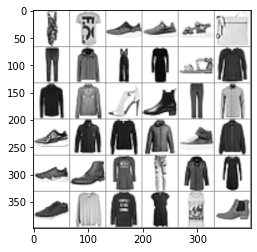

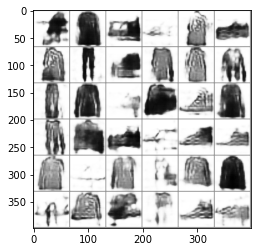

Epochs :  30  Step :  28200  Generator Loss :  0.6537271330120779  Critic Loss :  -1.2967235738853125


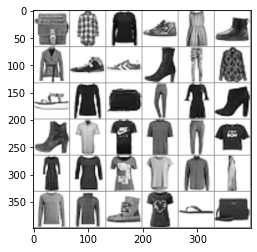

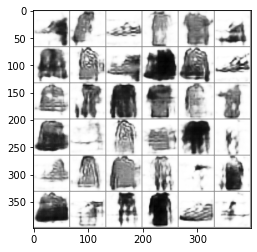

Epochs :  30  Step :  28300  Generator Loss :  0.6536710088249451  Critic Loss :  -1.2965887538668908


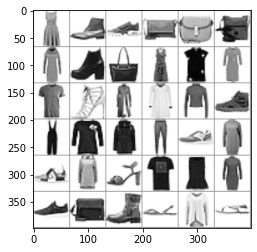

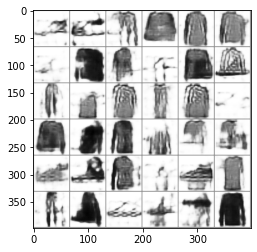

Epochs :  30  Step :  28400  Generator Loss :  0.6537013030442669  Critic Loss :  -1.2967202494396652


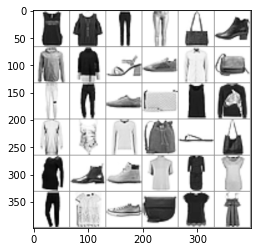

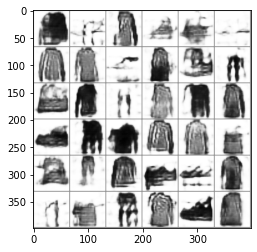

Epochs :  30  Step :  28500  Generator Loss :  0.6537400317716477  Critic Loss :  -1.2967213950822591


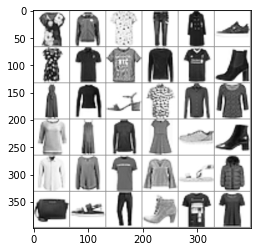

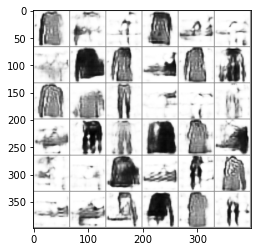

Epochs :  30  Step :  28600  Generator Loss :  0.6536396314030093  Critic Loss :  -1.296473868128548


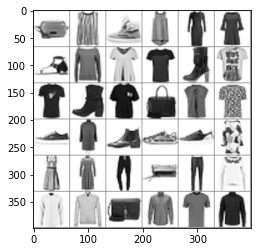

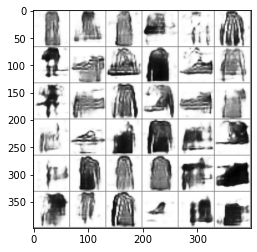

Epochs :  30  Step :  28700  Generator Loss :  0.6536554944571935  Critic Loss :  -1.29648048137106


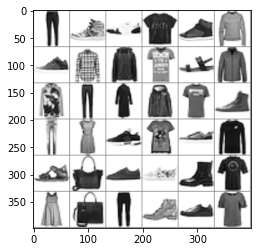

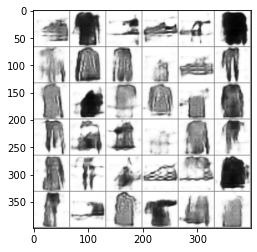

Epochs :  30  Step :  28800  Generator Loss :  0.6535536715635923  Critic Loss :  -1.296315045937726


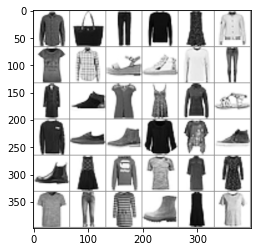

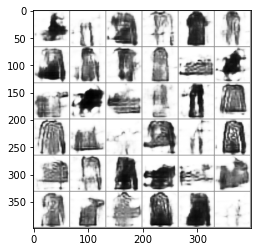

Epochs :  30  Step :  28900  Generator Loss :  0.6533536221704987  Critic Loss :  -1.2959666995977812


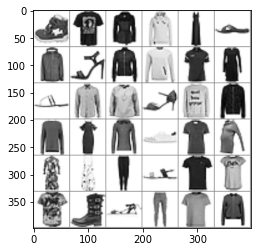

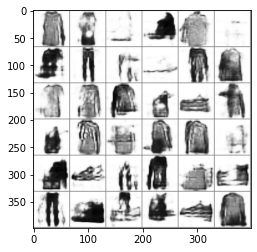

Epochs :  30  Step :  29000  Generator Loss :  0.6533330883514056  Critic Loss :  -1.2957590362986988


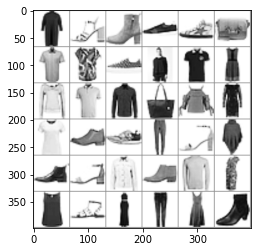

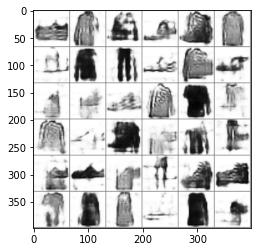

Epochs :  31  Step :  29100  Generator Loss :  0.6531804335206232  Critic Loss :  -1.2954030030177615


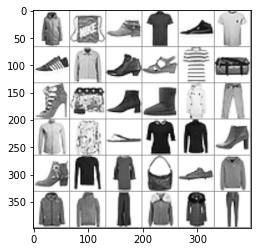

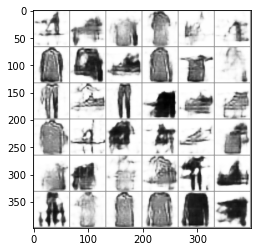

Epochs :  31  Step :  29200  Generator Loss :  0.6531073170678597  Critic Loss :  -1.2951967480568831


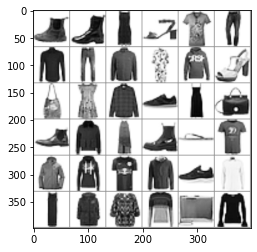

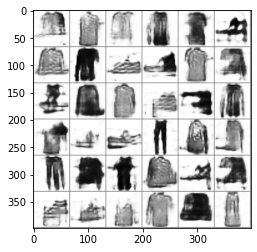

Epochs :  31  Step :  29300  Generator Loss :  0.6529089635519911  Critic Loss :  -1.2948388523616468


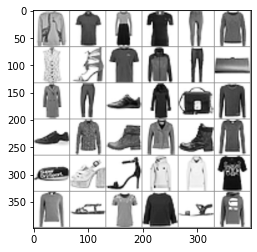

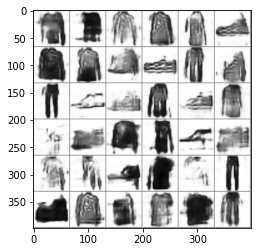

Epochs :  31  Step :  29400  Generator Loss :  0.6527445533598827  Critic Loss :  -1.2946504421504166


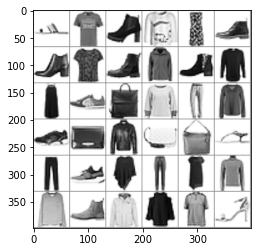

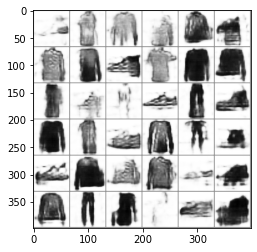

Epochs :  31  Step :  29500  Generator Loss :  0.6525773207167938  Critic Loss :  -1.2942969771799786


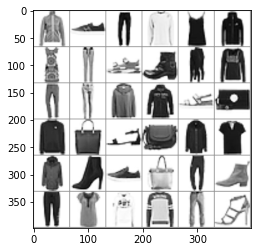

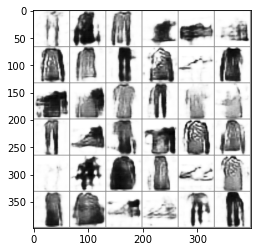

Epochs :  31  Step :  29600  Generator Loss :  0.6523405850792188  Critic Loss :  -1.2937411554574958


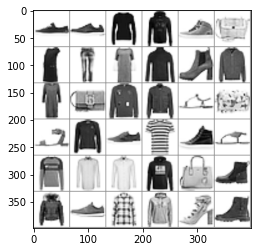

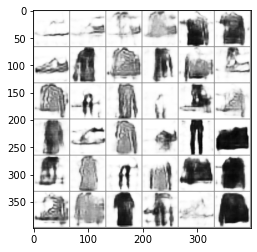

Epochs :  31  Step :  29700  Generator Loss :  0.6520389919409055  Critic Loss :  -1.2931584957691957


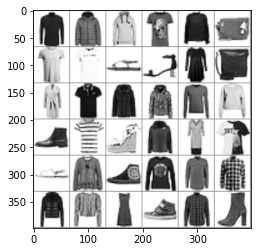

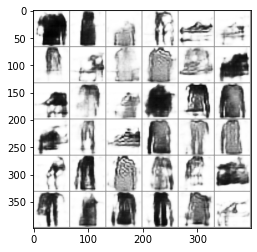

Epochs :  31  Step :  29800  Generator Loss :  0.6517943839321847  Critic Loss :  -1.292696234501889


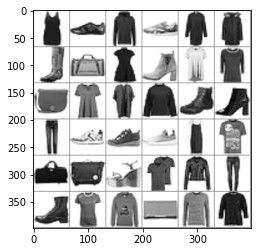

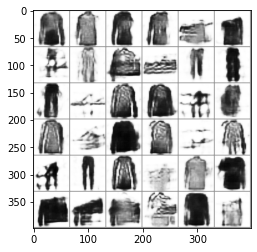

Epochs :  31  Step :  29900  Generator Loss :  0.6515805060146953  Critic Loss :  -1.292139175409698


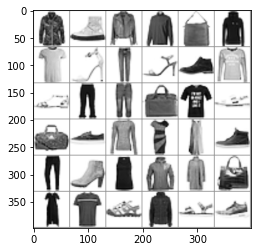

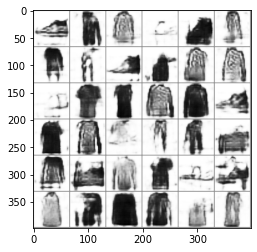

Epochs :  31  Step :  30000  Generator Loss :  0.6512300734128414  Critic Loss :  -1.2914135847692112


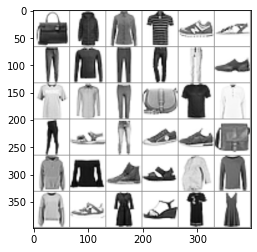

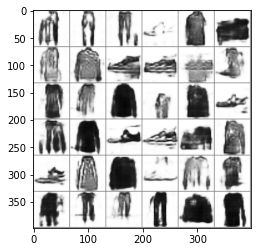

Epochs :  32  Step :  30100  Generator Loss :  0.6509991478711673  Critic Loss :  -1.291005188429714


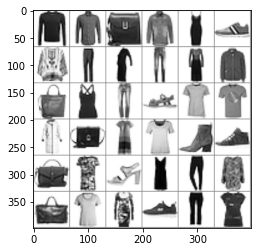

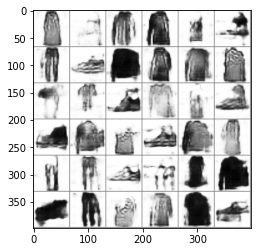

Epochs :  32  Step :  30200  Generator Loss :  0.6507630521307826  Critic Loss :  -1.29044987893385


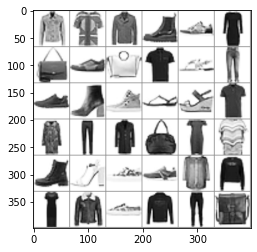

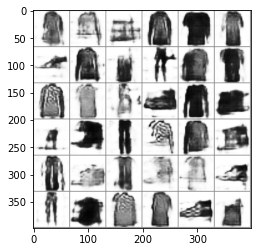

Epochs :  32  Step :  30300  Generator Loss :  0.650461460670461  Critic Loss :  -1.2898608606239752


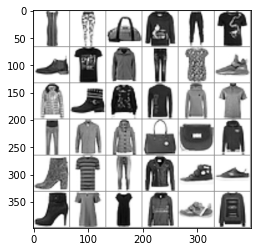

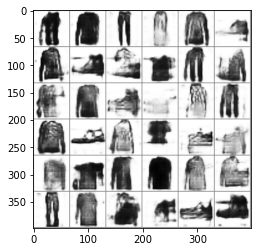

Epochs :  32  Step :  30400  Generator Loss :  0.6502647546103981  Critic Loss :  -1.2895034392931355


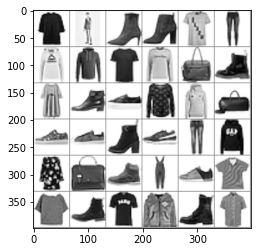

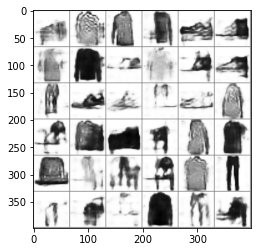

Epochs :  32  Step :  30500  Generator Loss :  0.6499853209265599  Critic Loss :  -1.2890294935994857


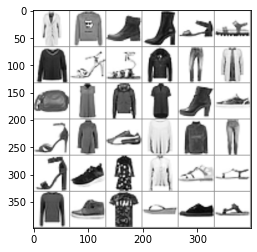

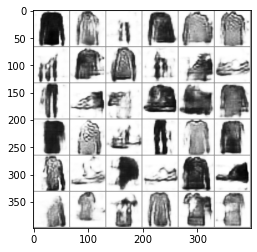

Epochs :  32  Step :  30600  Generator Loss :  0.6497924258008986  Critic Loss :  -1.288607049443013


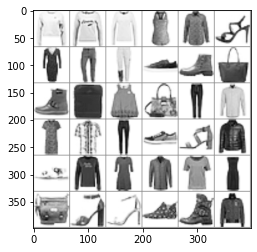

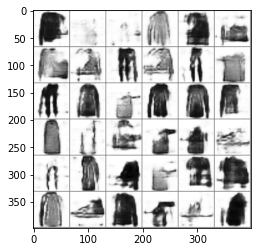

Epochs :  32  Step :  30700  Generator Loss :  0.6494967085049572  Critic Loss :  -1.2881031956626472


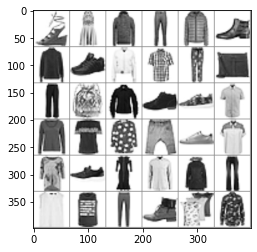

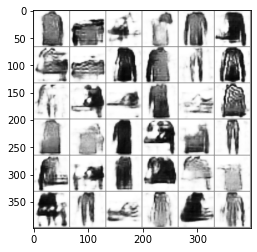

Epochs :  32  Step :  30800  Generator Loss :  0.6492190028987326  Critic Loss :  -1.2875758644294444


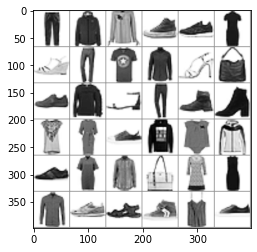

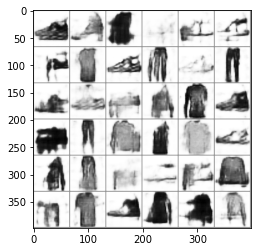

Epochs :  32  Step :  30900  Generator Loss :  0.6488898043716281  Critic Loss :  -1.2868711855479447


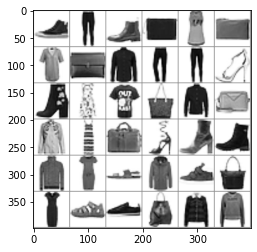

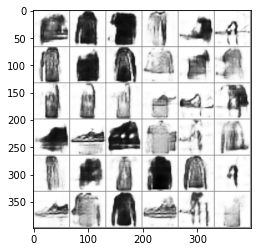

Epochs :  33  Step :  31000  Generator Loss :  0.6485209050921859  Critic Loss :  -1.2862199419312335


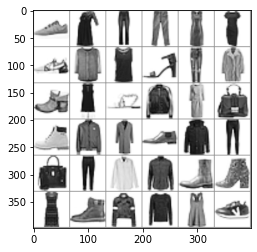

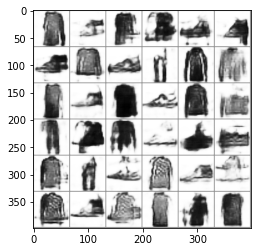

Epochs :  33  Step :  31100  Generator Loss :  0.6482285045679147  Critic Loss :  -1.285690204603535


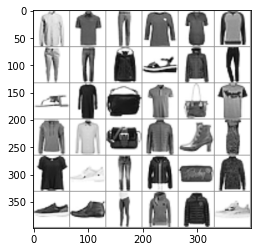

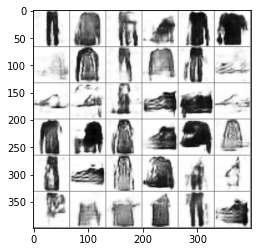

Epochs :  33  Step :  31200  Generator Loss :  0.6478869824327054  Critic Loss :  -1.285046253416249


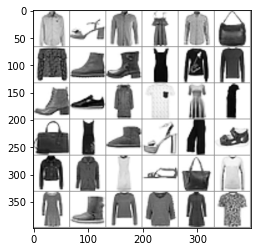

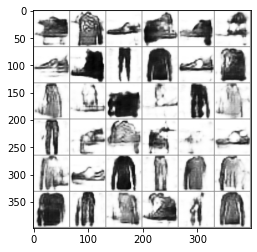

Epochs :  33  Step :  31300  Generator Loss :  0.6475460228536162  Critic Loss :  -1.284359268928148


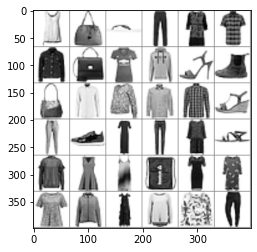

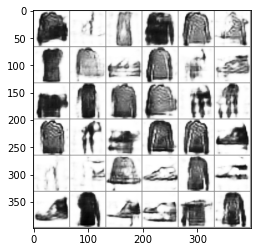

Epochs :  33  Step :  31400  Generator Loss :  0.6471566665969021  Critic Loss :  -1.2836043688571779


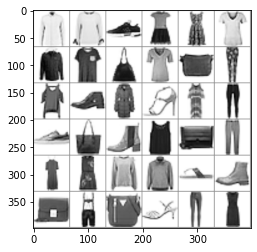

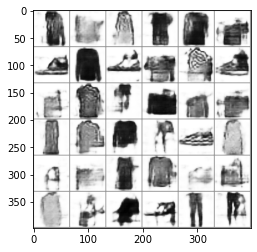

Epochs :  33  Step :  31500  Generator Loss :  0.6467418727008256  Critic Loss :  -1.282902065338069


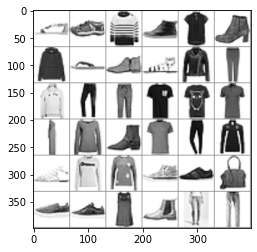

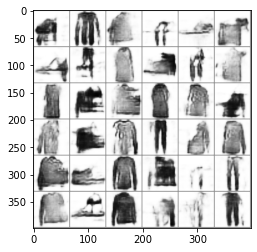

Epochs :  33  Step :  31600  Generator Loss :  0.6463705302713972  Critic Loss :  -1.2821849731429873


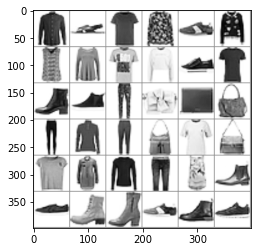

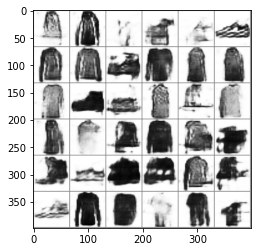

Epochs :  33  Step :  31700  Generator Loss :  0.646037452710882  Critic Loss :  -1.2815737316593798


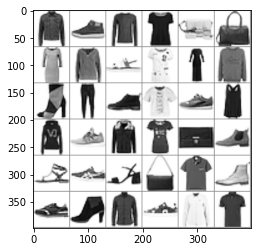

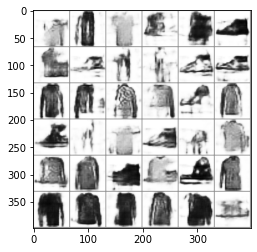

Epochs :  33  Step :  31800  Generator Loss :  0.6456133104926166  Critic Loss :  -1.2808138173091739


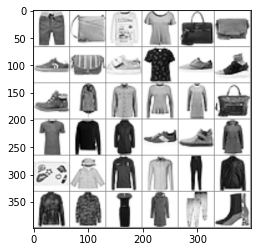

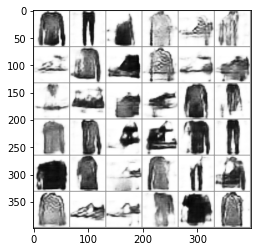

Epochs :  34  Step :  31900  Generator Loss :  0.6452226747436738  Critic Loss :  -1.28004287730736


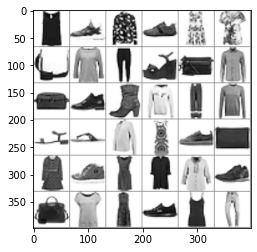

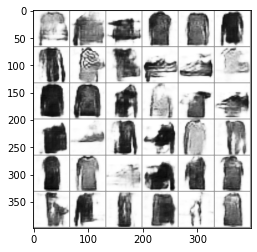

Epochs :  34  Step :  32000  Generator Loss :  0.6448069985739203  Critic Loss :  -1.279152939296182


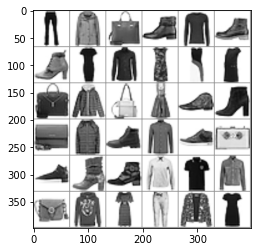

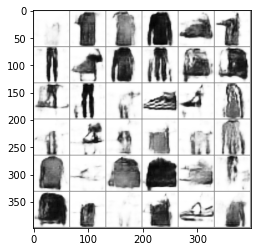

Epochs :  34  Step :  32100  Generator Loss :  0.6443658220776751  Critic Loss :  -1.2783390269263177


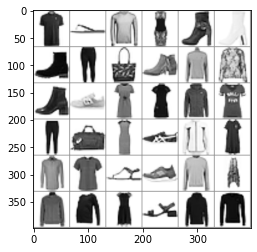

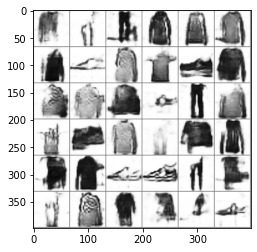

Epochs :  34  Step :  32200  Generator Loss :  0.6439126917472476  Critic Loss :  -1.2774559945075816


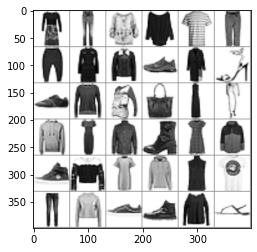

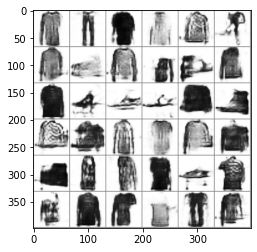

Epochs :  34  Step :  32300  Generator Loss :  0.6434998283628879  Critic Loss :  -1.2766682829604463


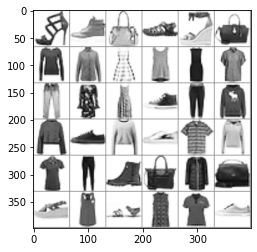

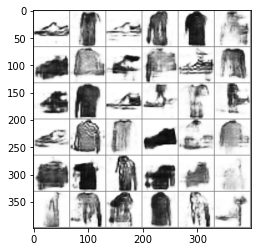

Epochs :  34  Step :  32400  Generator Loss :  0.6430953401871196  Critic Loss :  -1.2758510269068681


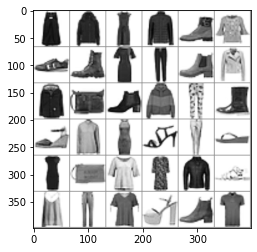

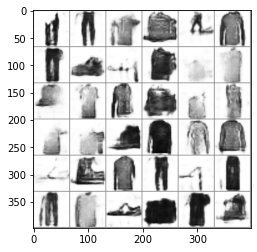

Epochs :  34  Step :  32500  Generator Loss :  0.642643339458244  Critic Loss :  -1.274948740513731


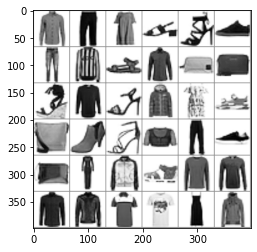

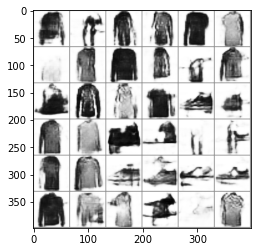

Epochs :  34  Step :  32600  Generator Loss :  0.6421997972285487  Critic Loss :  -1.2741107441435955


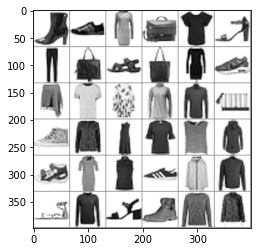

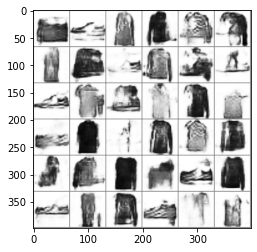

Epochs :  34  Step :  32700  Generator Loss :  0.6417200474177889  Critic Loss :  -1.273162098907406


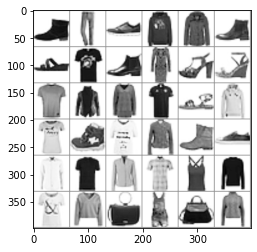

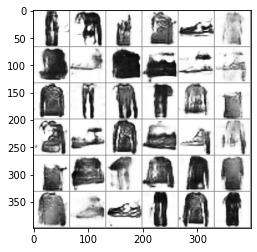

Epochs :  34  Step :  32800  Generator Loss :  0.641276345375312  Critic Loss :  -1.2722398369630694


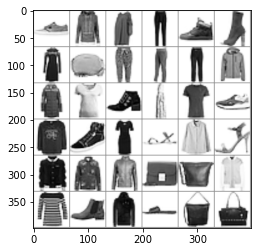

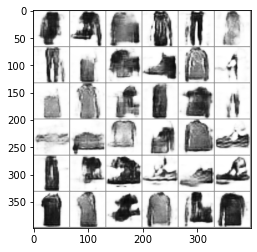

Epochs :  35  Step :  32900  Generator Loss :  0.6408553603861062  Critic Loss :  -1.2714284507226845


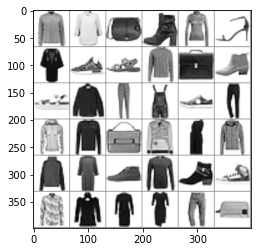

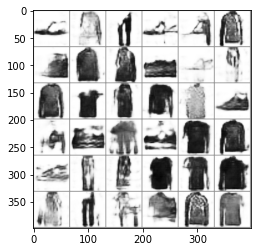

Epochs :  35  Step :  33000  Generator Loss :  0.6403854562371094  Critic Loss :  -1.2705168094844934


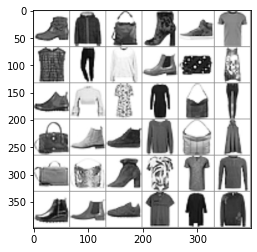

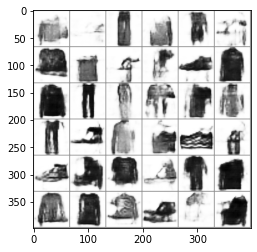

Epochs :  35  Step :  33100  Generator Loss :  0.6399138734230119  Critic Loss :  -1.2696053659212239


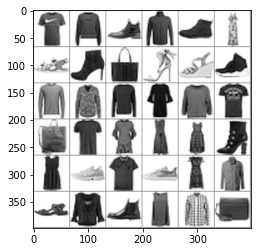

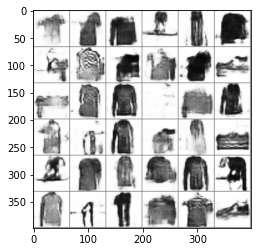

Epochs :  35  Step :  33200  Generator Loss :  0.6394701859338001  Critic Loss :  -1.2688341477714793


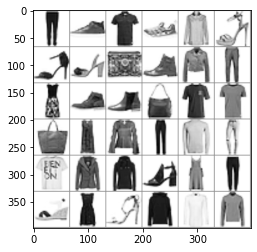

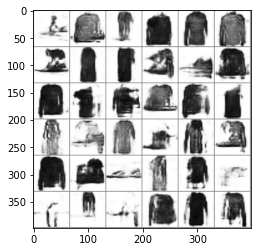

Epochs :  35  Step :  33300  Generator Loss :  0.6389704818463278  Critic Loss :  -1.2679331602368675


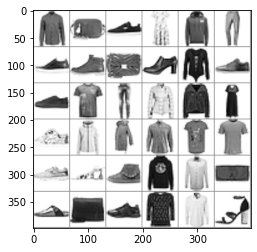

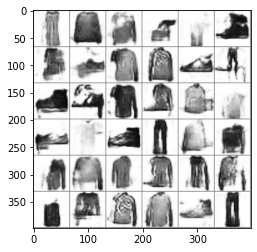

Epochs :  35  Step :  33400  Generator Loss :  0.6385436725261912  Critic Loss :  -1.26703109477509


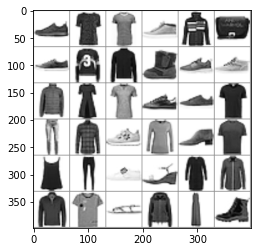

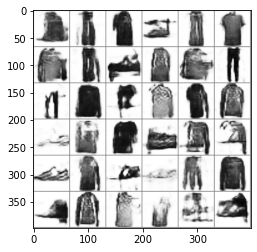

Epochs :  35  Step :  33500  Generator Loss :  0.6380380943777428  Critic Loss :  -1.2661122165368963


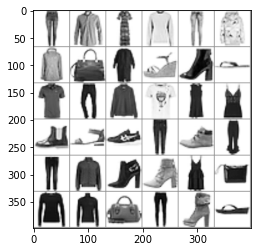

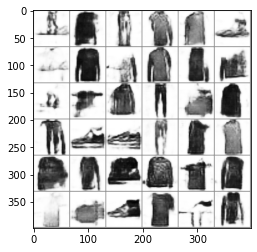

KeyboardInterrupt: 

In [9]:
current_step = 0
gen_losses = 0
critic_losses = 0
os.makedirs("WGAN", exist_ok=True)

for epoch in range(n_epochs):
    for real, _ in(dataloader):
        real = real.to(device)
        
        mean_critic_loss = 0
        for _ in range(critic_steps):
            critic_opt.zero_grad()
            fake_noise = get_noise(len(real), z_dim)
            fake = gen(fake_noise)
            critic_preds_fake = critic(fake.detach()).reshape(-1)
            critic_preds_real = critic(real).reshape(-1)
            
            critic_loss = -(torch.mean(critic_preds_real) - torch.mean(critic_preds_fake)) 
            mean_critic_loss += critic_loss.item() / critic_steps
            critic_loss.backward(retain_graph = True)
            critic_opt.step()       
            for p in critic.parameters():
                p.data.clamp_(-0.01, 0.01)
        
        critic_losses += mean_critic_loss #
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(len(real), z_dim)
        fake_2 = gen(fake_noise_2)
        critic_preds_fake = critic(fake_2).reshape(-1)
        gen_loss = -torch.mean(critic_preds_fake)
        gen_loss.backward()
        gen_opt.step()
        
        gen_losses += gen_loss.item() #
        
        
        if current_step % steps == 0 and current_step > 0 :
            print('Epochs : ', epoch, ' Step : ', current_step, ' Generator Loss : ', (gen_losses / current_step), ' Critic Loss : ', (critic_losses / current_step)) 
            img_grid_real = torchvision.utils.make_grid(real[:36], nrow = 6)
            img_grid_fake = torchvision.utils.make_grid(fake[:36], nrow = 6)
            save_image(fake.data[:36], "WGAN/%d.png" % current_step, nrow=6, normalize=True)
            matplotlib_imshow(img_grid_real, one_channel=True)
            matplotlib_imshow(img_grid_fake,  one_channel=True)
        
        current_step += 1
